<a href="https://colab.research.google.com/github/camillabocciolone/Leonardo-project/blob/main/eegpt_vs_fda_LOSO_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# import necessari librerie e files

## import libraries

In [1]:
!pip -q install einops tqdm scikit-learn scipy

import os, sys, numpy as np, torch
from pathlib import Path
from scipy.signal import resample_poly
from tqdm.auto import tqdm
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

import os, json
import numpy as np
import pandas as pd

from scipy.signal import butter, filtfilt, iirnotch, resample_poly, detrend
from sklearn.model_selection import GroupKFold, GroupShuffleSplit
import torch
from torch.utils.data import Dataset
from torch.utils.data import DataLoader



## --- Repo EEGPT ---

In [2]:
# (opzionale) aggiorna pip/setuptools/wheel per massimizzare compatibilità
!pip install -U pip setuptools wheel

# install minimo per il tuo script
!pip install numpy scipy scikit-learn einops tqdm

# torch: in Colab di solito è già installato; se no:
!pip install torch --index-url https://download.pytorch.org/whl/cpu



   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.8/1.8 MB 17.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 18.2 MB/s eta 0:00:00
  Attempting uninstall: setuptools
    Found existing installation: setuptools 75.2.0
    Uninstalling setuptools-75.2.0:
      Successfully uninstalled setuptools-75.2.0
  Attempting uninstall: pip
    Found existing installation: pip 24.1.2
    Uninstalling pip-24.1.2:
      Successfully uninstalled pip-24.1.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
ipython 7.34.0 requires jedi>=0.16, which is not installed.


Looking in indexes: https://download.pytorch.org/whl/cpu


## montare il drive

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## Usa il checkpoint direttamente da Drive

In [4]:
from pathlib import Path

ckpt_path = Path(
    "/content/drive/MyDrive/EEGPT/checkpoint/eegpt_mcae_58chs_4s_large4E.ckpt"
)

print("Checkpoint exists:", ckpt_path.exists())


Checkpoint exists: True


## Clona il repo

In [5]:
from pathlib import Path
import os

%cd /content
if not Path("/content/EEGPT").exists():
    !git clone -q https://github.com/BINE022/EEGPT.git

print("Repo OK:", Path("/content/EEGPT").exists())
print("Has downstream:", Path("/content/EEGPT/downstream").exists())


/content
Repo OK: True
Has downstream: True


## Import del modello

In [6]:
import importlib.util
from pathlib import Path

path = Path("/content/EEGPT/downstream/Modules/models/EEGPT_mcae_finetune.py")
print("Model file exists:", path.exists(), path)

spec = importlib.util.spec_from_file_location("eegpt_mcae_finetune", str(path))
mod = importlib.util.module_from_spec(spec)
spec.loader.exec_module(mod)

EEGPTClassifier = mod.EEGPTClassifier
CHANNEL_DICT = mod.CHANNEL_DICT

print("Import OK. CHANNEL_DICT size:", len(CHANNEL_DICT))


Model file exists: True /content/EEGPT/downstream/Modules/models/EEGPT_mcae_finetune.py
Import OK. CHANNEL_DICT size: 62


/content/EEGPT/downstream/Modules/models/EEGPT_mcae_finetune.py:679: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  @autocast(True)
/content/EEGPT/downstream/Modules/models/EEGPT_mcae_finetune.py:693: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  @autocast(True)


# EEGPT on the true dataset

In [7]:
data_dir = "/content/drive/My Drive/LL2/LL2/raw_data"

levels = ["natural", "lowlevel", "midlevel", "highlevel"]   # y=0,1,2
tasks  = ["Stroop"]
subjects = range(1, 16)

C = 8
fs_in = 250
FS_OUT = 256
EPOCH_SEC, STRIDE_SEC = 4.0, 2.0
BP_LO, BP_HI = 0.5, 45.0
NOTCH_F0, NOTCH_Q = 50.0, 30.0

# canali OpenBCI (devono essere in CHANNEL_DICT)
my_channels = ["Fp1","Fp2","F7","F3","FZ","F4","F8","C2"]
use_channels_names = [c.upper().strip('.') for c in my_channels]
for c in use_channels_names:
    assert c in CHANNEL_DICT, f"Canale non riconosciuto in CHANNEL_DICT: {c}"
print("Use channels:", use_channels_names)


Use channels: ['FP1', 'FP2', 'F7', 'F3', 'FZ', 'F4', 'F8', 'C2']


## definiamo funzioni per la lettura e preprocessing dei dati

In [8]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from scipy.interpolate import interp1d

def find_file(level, task, subject):
    # layout A: {level}_Data/{task}-{subject}.txt
    p1 = os.path.join(data_dir, f"{level}_Data", f"{task}-{subject}.txt")
    # layout B: {task}_Data/{level}-{subject}.txt
    p2 = os.path.join(data_dir, f"{task}_Data",  f"{level}-{subject}.txt")
    if os.path.exists(p1): return p1
    if os.path.exists(p2): return p2
    return None

def load_ct_matrix(path, C=8):
    df = pd.read_csv(path, sep=",", header=None, engine="python")
    df = df.iloc[1:, :].reset_index(drop=True)

    # EEG: prime C colonne → (T,C)
    X = df.iloc[:, :C].to_numpy(dtype=np.float32)

    # TIME (se ti serve)
    T = X.shape[0]
    t = np.arange(T) / 250.0

    return X, t   # X:(T,C)


def bandpass(x, fs, lo=BP_LO, hi=BP_HI, order=4):
    nyq = 0.5 * fs
    b, a = butter(order, [lo/nyq, hi/nyq], btype="band")
    return filtfilt(b, a, x, axis=0)

def notch50(x, fs, f0=NOTCH_F0, Q=NOTCH_Q):
    b, a = iirnotch(w0=f0/(fs/2), Q=Q)
    return filtfilt(b, a, x, axis=0)

def resample_to(x, fs_in, fs_out):
    if fs_in == fs_out:
        return x
    # per 250->256 puoi usare direttamente 128/125
    if int(fs_in)==250 and int(fs_out)==256:
        return resample_poly(x, 128, 125, axis=0)
    # fallback generico
    from math import gcd
    g = gcd(int(fs_in), int(fs_out))
    up, down = fs_out//g, fs_in//g
    return resample_poly(x, up, down, axis=0)

def robust_clip(x, q=0.999):
    hi = np.quantile(x, q, axis=0, keepdims=True)
    lo = np.quantile(x, 1-q, axis=0, keepdims=True)
    return np.clip(x, lo, hi)

def epoch_signal(x_tc, fs, epoch_sec=EPOCH_SEC, stride_sec=STRIDE_SEC):
    # x_tc: (T,C)
    win = int(epoch_sec * fs)
    step = int(stride_sec * fs)
    T = x_tc.shape[0]
    starts = np.arange(0, T - win + 1, step)
    if len(starts)==0:
        return np.empty((0, win, x_tc.shape[1]), dtype=np.float32)
    epochs = np.stack([x_tc[s:s+win] for s in starts], axis=0)  # (N, win, C)
    return epochs

def preprocess_recording(X, t=None, debug=False, ch_idx=0):
    # X: (T,C), t: (T,) in secondi (o ms), monotono

    # filtri: non cambiano la lunghezza

    # 1) preprocess leggero a 250 (opzionale, ma ok)
    x = detrend(X, axis=0, type="linear")
    x = robust_clip(x, q=0.999)

    # 2) resample 250 -> 256
    x = resample_to(x, fs_in, FS_OUT)               # (T256, C)
    t_256 = t[0] + np.arange(x.shape[0]) / FS_OUT   # (T256,)

    # 3) filtri a 256 (coerenti col segnale)
    x = bandpass(x, FS_OUT)
    x = notch50(x, FS_OUT)

    if debug:
        plt.figure(figsize=(12,4))
        plt.plot(t, X[:, ch_idx], '.', alpha=0.4, label="original (250 Hz)")
        plt.xlabel("Time (s)")
        plt.ylabel("Amplitude")
        plt.legend()
        plt.grid(alpha=0.3)
        plt.tight_layout()
        plt.show()

    # 4) epoche a 256
    epochs_tc = epoch_signal(x, FS_OUT)  # (N, win, C)
    if epochs_tc.shape[0] == 0:
        win = int(EPOCH_SEC * FS_OUT)
        return np.empty((0, X.shape[1], win), dtype=np.float32), None

    epochs = np.transpose(epochs_tc, (0, 2, 1))  # (N, C, win)

    win = int(EPOCH_SEC * FS_OUT)
    step = int(STRIDE_SEC * FS_OUT)
    starts = np.arange(0, x.shape[0] - win + 1, step)
    t_epochs = np.stack([t_256[s:s+win] for s in starts], axis=0)  # (N, win)

    if debug and epochs.shape[0] > 0:
        e = 23
        if e >= epochs.shape[0]:
            e = 0  # fallback se hai meno di 24 epoche

        plt.figure(figsize=(12,4))
        plt.plot(t_epochs[e], epochs[e, ch_idx, :])
        plt.xlabel("Time (s)")
        plt.ylabel("Amplitude")
        plt.title(f"Epoch[{e}] (ch {ch_idx})")
        plt.grid(alpha=0.3)
        plt.tight_layout()
        plt.show()


    # 5) robust z-score per epoca/canale
    med = np.median(epochs, axis=-1, keepdims=True)
    mad = np.median(np.abs(epochs - med), axis=-1, keepdims=True) + 1e-8
    #epochs = (epochs - med) / (1.4826 * mad)
    if debug and epochs.shape[0] > 0:
        e = 23
        if e >= epochs.shape[0]:
            e = 0  # fallback se hai meno di 24 epoche

        plt.figure(figsize=(12,4))
        plt.plot(t_epochs[e], epochs[e, ch_idx, :])
        plt.xlabel("Time (s)")
        plt.ylabel("Amplitude")
        plt.title(f"Epoch[{e}] (ch {ch_idx})")
        plt.grid(alpha=0.3)
        plt.tight_layout()
        plt.show()

    return epochs.astype(np.float32), t_epochs







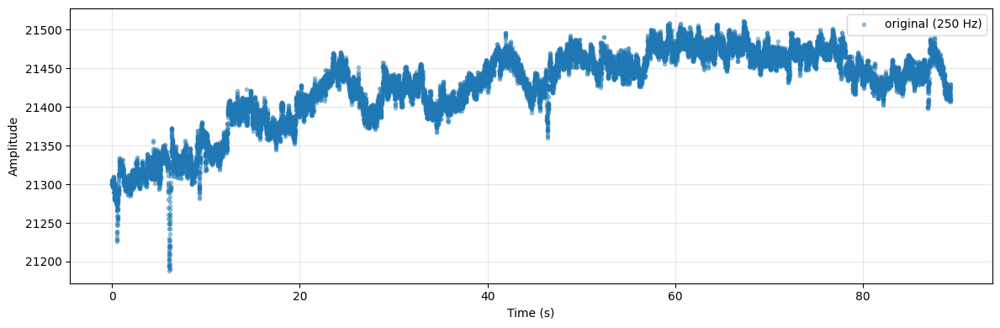

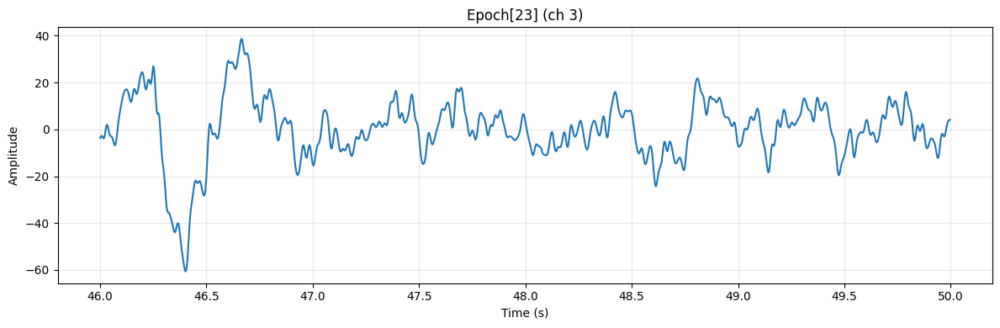

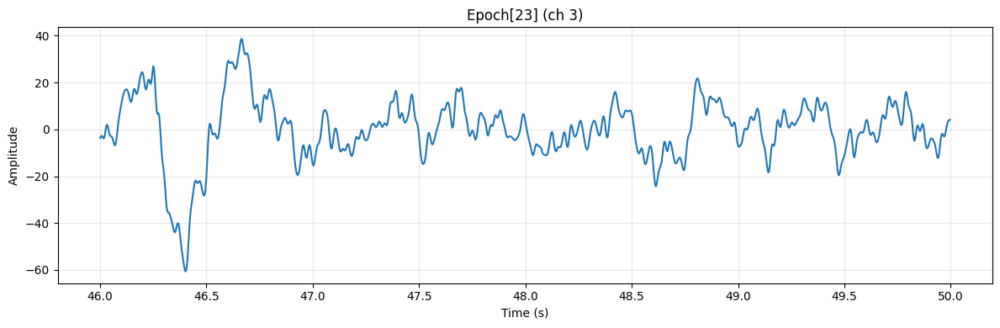

(43, 8, 1024)


In [9]:
task = "Stroop"
level = "lowlevel"
subject = 8

path = find_file(level, task, subject)
X, t = load_ct_matrix(path)

epochs, t_epochs = preprocess_recording(
    X, t,
    debug=True,
    ch_idx=3
)

print(epochs.shape)  # (N, C, win)




## build_all

**definiamo build all usando rec_id**

**Scopo**: oltre a subject, crea anche un ID del recording in modo che si possa fare split “a livello di registrazione” (recording-level) e poi prendere tutte le finestre di quella registrazione insieme

In [10]:
def build_all(levels, tasks, subjects, C=8):
    X_list, y_list, subj_list, rec_list = [], [], [], []
    for li, level in enumerate(levels):
        for task in tasks:
            for s in subjects:
                path = find_file(level, task, s)
                if path is None:
                    print(f"[SKIP] missing file: {level}/{task}/S{s}")
                    continue
                try:

                    X, t = load_ct_matrix(path, C=C)
                    epochs, _ = preprocess_recording(X, t=t)
                    if epochs.shape[0]==0:
                        print(f"[SKIP] no epochs: {os.path.basename(path)}")
                        continue

                    rec_id = f"{task}|{level}|S{s}"
                    X_list.append(epochs)
                    y_list.extend([li] * len(epochs))
                    subj_list.extend([f"S{s}"]*len(epochs))
                    rec_list.extend([rec_id]*len(epochs))
                except Exception as e:
                    print(f"[ERROR] {os.path.basename(path)}: {e}")
                    continue

    X_all = np.concatenate(X_list, axis=0) if X_list else np.empty((0,C,int(EPOCH_SEC*FS_OUT)), dtype=np.float32)
    y_all = np.array(y_list, dtype=np.int64)
    meta = {
        "subject": np.array(subj_list),
        "rec_id":  np.array(rec_list),
    }
    return X_all, y_all, meta

X_all, y_all, meta = build_all(levels, tasks, subjects, C=8)
print("X_all:", X_all.shape, "y_all:", y_all.shape, "unique rec:", len(np.unique(meta["rec_id"])))


X_all: (2520, 8, 1024) y_all: (2520,) unique rec: 60


In [11]:
X_all = np.asarray(X_all)
y_all = np.asarray(y_all)

meta["rec_id"]  = np.asarray(meta["rec_id"]).astype(str).reshape(-1)
meta["subject"] = np.asarray(meta["subject"]).astype(str).reshape(-1)

assert len(meta["rec_id"])  == len(y_all) == X_all.shape[0]
assert len(meta["subject"]) == len(y_all)


## recording-level prediction

Questo blocco serve a fare cross-validation a livello di registrazione (non di finestra), mantenendo l’indipendenza tra soggetti, e poi usare quei recording per selezionare le finestre giuste

In [12]:
print("X_all:", X_all.shape)
print("y_all:", y_all.shape, "meta rec:", meta["rec_id"].shape)
print("unique rec:", len(np.unique(meta["rec_id"])))


X_all: (2520, 8, 1024)
y_all: (2520,) meta rec: (2520,)
unique rec: 60


In [13]:
rec_id_win = meta["rec_id"].astype(str)
subj_win   = meta["subject"].astype(str)

rec_ids = np.unique(rec_id_win)
rec_to_subj = {rid: rid.split("|")[-1] for rid in rec_ids}  # oppure costruita da meta
rec_subj = np.array([rec_to_subj[r] for r in rec_ids])

# label per recording: prendi la prima finestra e ASSERTA coerenza
rec_y = []
for rid in rec_ids:
    idx = np.where(rec_id_win == rid)[0]
    ys = np.unique(y_all[idx])
    assert len(ys) == 1, f"{rid} ha labels diverse: {ys}"
    rec_y.append(int(ys[0]))
rec_y = np.array(rec_y, dtype=np.int64)

subjects = np.unique(rec_subj)  # es. ["S1",...,"S15"]


WindowDataset e i DataLoader fanno solo tre cose:
- selezionano le finestre giuste con la maschera (rec_id ∈ train_rec/val_rec/test_rec)
- tengono in memoria self.X/self.y/self.r
- in __getitem__ trasformano self.X[i] e self.y[i] in tensori torch

## definizione modello

In [14]:
import numpy as np
import torch

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Device:", device)

# --- 1) Lista ufficiale dei 58 canali (ordine ESATTO EEGPT 58ch) ---
CHANNELS_58 = [
    'FP1','FPZ','FP2',
    'AF3','AF4',
    'F7','F5','F3','F1','FZ','F2','F4','F6','F8',
    'FT7','FC5','FC3','FC1','FCZ','FC2','FC4','FC6','FT8',
    'T7','C5','C3','C1','CZ','C2','C4','C6','T8',
    'TP7','CP5','CP3','CP1','CPZ','CP2','CP4','CP6','TP8',
    'P7','P5','P3','P1','PZ','P2','P4','P6','P8',
    'PO7','PO3','POZ','PO4','PO8',
    'O1','OZ','O2'
]
assert len(CHANNELS_58) == 58

# --- 2) I tuoi 8 canali ---
my_channels = ["Fp1","Fp2","F7","F3","FZ","F4","F8","C2"]
use_channels_8 = [c.upper().strip('.') for c in my_channels]

# Mappa: nome_canale -> indice nel vettore 58
idx58 = {ch: i for i, ch in enumerate(CHANNELS_58)}

# Sanity check
for ch in use_channels_8:
    assert ch in idx58, f"Canale {ch} non è nei 58 canali EEGPT"

chan_ids_8 = [idx58[ch] for ch in use_channels_8]
print("8ch:", use_channels_8)
print("chan_ids_8 (posizioni nel 58):", chan_ids_8)

# --- 3) Embedding 8 -> 58 (baseline: zero-fill canali mancanti) ---
def embed_8_to_58(xb_8: torch.Tensor, chan_ids_8: list[int]) -> torch.Tensor:
    """
    xb_8: (B, 8, T) nei canali nell'ordine di use_channels_8
    ritorna: (B, 58, T) nell'ordine CHANNELS_58
    """
    assert xb_8.ndim == 3, "xb_8 deve essere (B,8,T)"
    B, C8, T = xb_8.shape
    assert C8 == 8, f"attesi 8 canali, trovati {C8}"
    xb_58 = torch.zeros((B, 58, T), device=xb_8.device, dtype=xb_8.dtype)
    xb_58[:, chan_ids_8, :] = xb_8
    return xb_58

# --- 4) Estrazione feature EEGPT ---
@torch.no_grad()
def extract_eegpt_features(model, loader, device, chan_ids_8):
    """
    loader deve restituire: xb, yb, rid
    xb: (B,8,T)
    """
    feats_all, y_all_out, rec_all = [], [], []
    for xb, yb, rid in loader:
        xb = xb.to(device).float()           # (B,8,T)
        xb58 = embed_8_to_58(xb, chan_ids_8) # (B,58,T)

        feats = model.forward_features(xb58) # (B,D) se così è definito nel tuo EEGPTClassifier
        feats_all.append(feats.detach().cpu())
        y_all_out.append(yb.detach().cpu())

        # rid può essere list/np/torch: normalizziamo a stringhe
        if isinstance(rid, torch.Tensor):
            rid = rid.detach().cpu().numpy()
        rec_all.extend(list(np.asarray(rid).astype(str)))

    return torch.cat(feats_all, 0), torch.cat(y_all_out, 0), np.asarray(rec_all, dtype=str)





Device: cuda
8ch: ['FP1', 'FP2', 'F7', 'F3', 'FZ', 'F4', 'F8', 'C2']
chan_ids_8 (posizioni nel 58): [0, 2, 5, 7, 9, 11, 13, 28]


In [15]:

# --- Creazione modello EEGPT ---
model = EEGPTClassifier(
    num_classes=4,
    in_channels=58,
    img_size=[58, 1024],
    patch_stride=128,
    desired_time_len=1024,
    use_channels_names=CHANNELS_58,   # <-- LISTA CORRETTA
    ckpt_path=str(ckpt_path),
).to(device)

model.eval()
for p in model.parameters():
    p.requires_grad = False

print("Model ready.")




Model ready.


## LOSO

### pesi


LOSO Confusion matrix:
 [[3 5 6 1]
 [3 3 6 3]
 [3 7 2 3]
 [3 2 3 7]]

LOSO Report:
               precision    recall  f1-score   support

           0      0.250     0.200     0.222        15
           1      0.176     0.200     0.188        15
           2      0.118     0.133     0.125        15
           3      0.500     0.467     0.483        15

    accuracy                          0.250        60
   macro avg      0.261     0.250     0.254        60
weighted avg      0.261     0.250     0.254        60


LOSO WINDOW-LEVEL
Balanced Accuracy: 0.33753190508611786
Accuracy: 0.36904761904761907
Confusion matrix:
 [[301 165 165 113]
 [160 103  97  99]
 [158 128 104  92]
 [161 131 121 422]]

Report:
               precision    recall  f1-score   support

           0      0.386     0.405     0.395       744
           1      0.195     0.224     0.209       459
           2      0.214     0.216     0.215       482
           3      0.581     0.505     0.541       835

    accuracy   

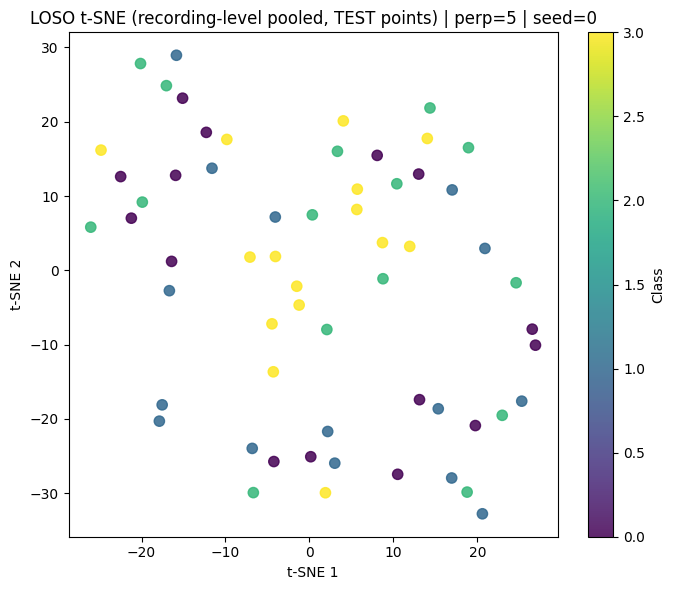

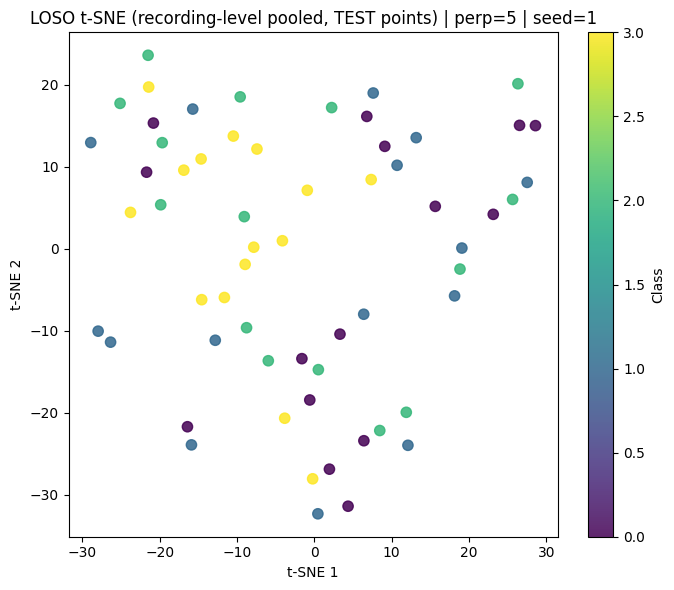

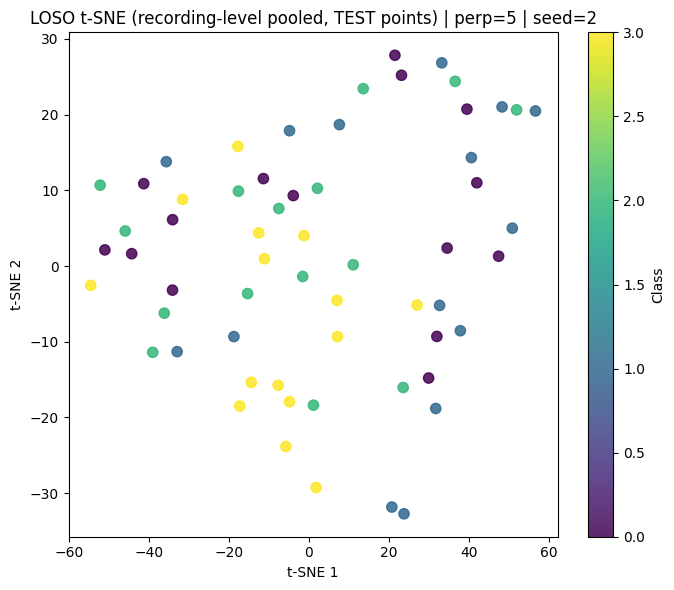

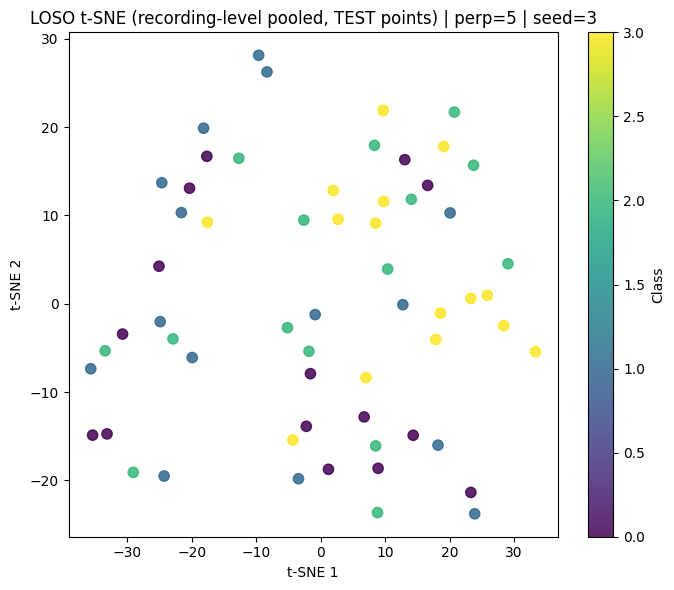

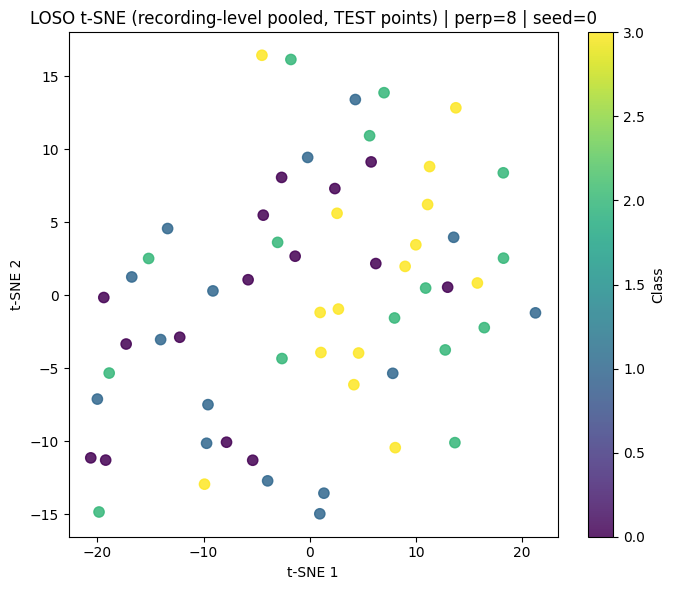

...

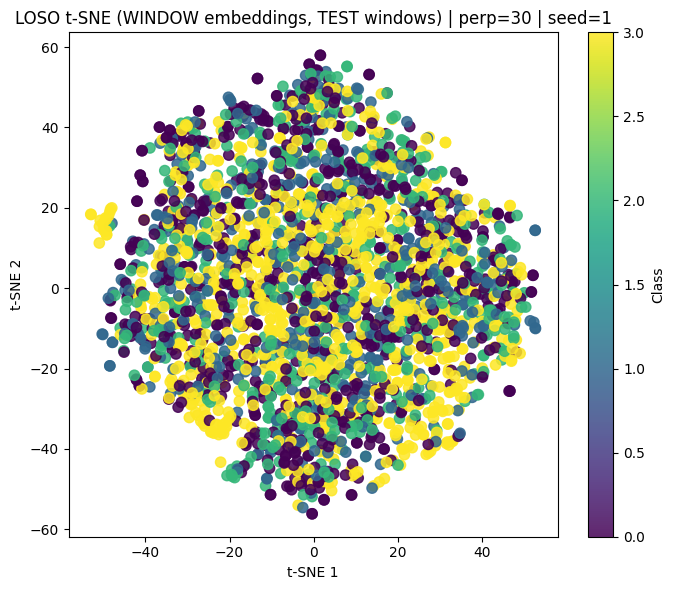

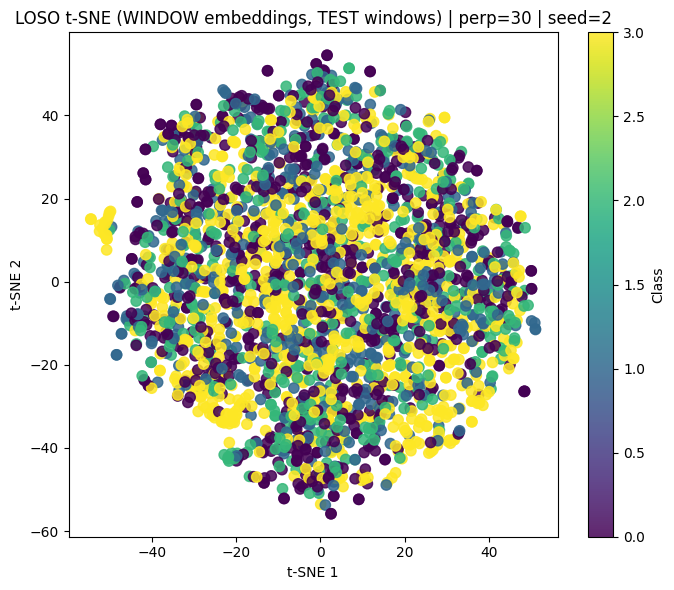

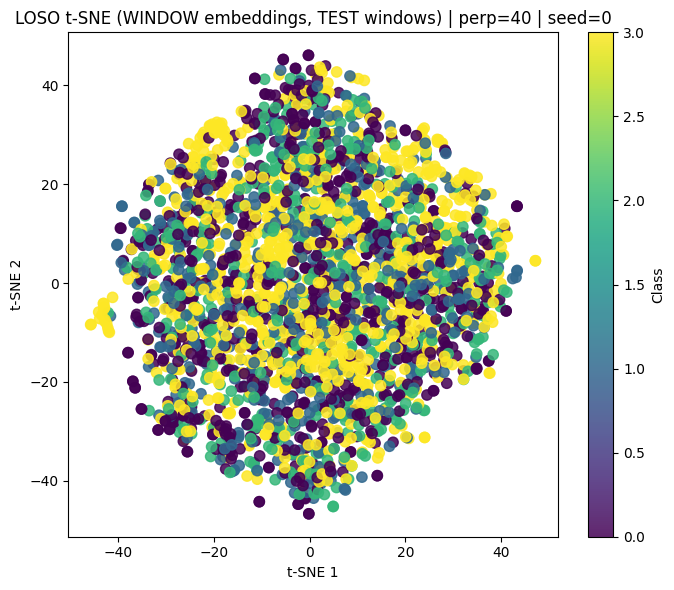

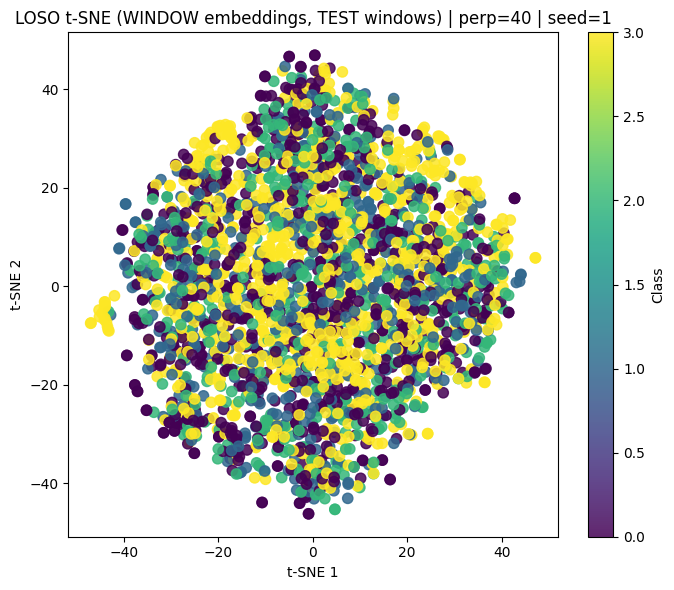

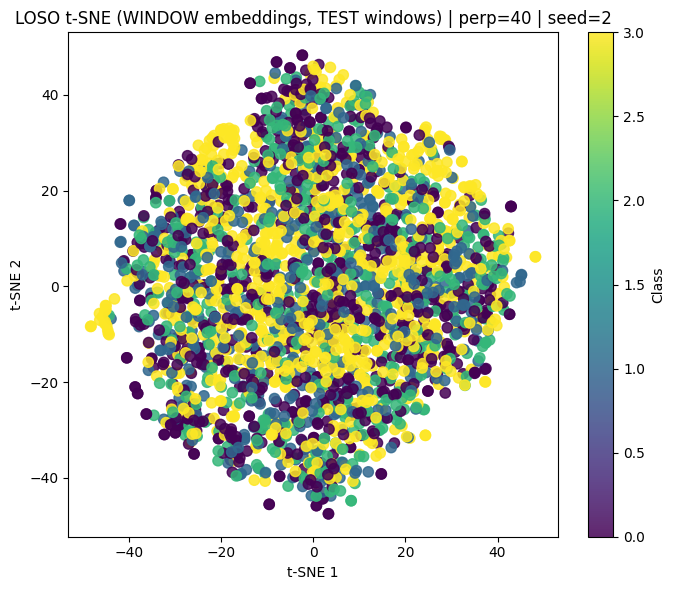

In [17]:
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
import matplotlib.pyplot as plt

from sklearn.model_selection import GroupShuffleSplit
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.metrics import (
    confusion_matrix,
    classification_report,
    balanced_accuracy_score,
    accuracy_score
)
import torch.nn as nn

# =========================
# Utils
# =========================


def make_class_weights(y, num_classes):
    y = np.asarray(y).astype(int)
    counts = np.bincount(y, minlength=num_classes)
    counts = np.maximum(counts, 1)  # evita div/0 se una classe manca nel train
    N = counts.sum()
    w = N / (num_classes * counts)
    return torch.tensor(w, dtype=torch.float32)

def to_np(x):
    if isinstance(x, torch.Tensor):
        return x.detach().cpu().numpy()
    return np.asarray(x)

def to_str_np(x):
    return np.asarray(to_np(x)).astype(str).reshape(-1)


def pool_by_recording_torch(feat, y, rec):
    rec = np.asarray(rec).astype(str)
    uniq = np.unique(rec)
    Xr, Yr = [], []
    for rid in uniq:
        m = (rec == rid)
        Xr.append(feat[m].mean(dim=0))
        Yr.append(int(y[m][0].item()))
    return torch.stack(Xr, 0), torch.tensor(Yr, dtype=torch.long), uniq

# =========================
# MLP
# =========================
class MLP(nn.Module):
    def __init__(self, d_in, n_classes):
        super().__init__()
        self.net = nn.Sequential(
            nn.Linear(d_in, 256), nn.ReLU(), nn.Dropout(0.2),
            nn.Linear(256, 128), nn.ReLU(), nn.Dropout(0.2),
            nn.Linear(128, n_classes),
        )
    def forward(self, x):
        return self.net(x)

def train_mlp_with_val(Xtr_np, ytr_np, Xva_np, yva_np, num_classes, device,
                       max_epochs=300, patience=30, lr=1e-3, wd=1e-4):
    Xtr = torch.tensor(Xtr_np, dtype=torch.float32).to(device)
    Xva = torch.tensor(Xva_np, dtype=torch.float32).to(device)
    ytr = torch.tensor(ytr_np, dtype=torch.long).to(device)
    yva = torch.tensor(yva_np, dtype=torch.long).to(device)

    clf = MLP(Xtr.shape[1], num_classes).to(device)

    class_w = make_class_weights(ytr_np, num_classes).to(device)
    crit = nn.CrossEntropyLoss(weight=class_w)

    opt  = optim.AdamW(clf.parameters(), lr=lr, weight_decay=wd)

    @torch.no_grad()
    def val_acc():
        clf.eval()
        pred = clf(Xva).argmax(1)
        return (pred == yva).float().mean().item()

    best, best_state, noimp = -1, None, 0
    for _ in range(max_epochs):
        clf.train()
        opt.zero_grad(set_to_none=True)
        loss = crit(clf(Xtr), ytr)
        loss.backward()
        opt.step()

        va = val_acc()
        if va > best:
            best = va
            best_state = {k: v.detach().cpu().clone() for k, v in clf.state_dict().items()}
            noimp = 0
        else:
            noimp += 1
            if noimp >= patience:
                break

    if best_state is not None:
        clf.load_state_dict(best_state)
    return clf

# =========================
# Dataset (rec_id filter robust)
# =========================
from torch.utils.data import Dataset, DataLoader

class WindowDataset(Dataset):
    def __init__(self, X_all, y_all, rec_id_all, keep_rec_set):
        X_all = np.asarray(X_all)
        y_all = np.asarray(y_all)

        rec_id_all = np.asarray(rec_id_all).astype(str).reshape(-1)
        assert len(rec_id_all) == len(y_all) == X_all.shape[0], \
            f"Mismatch: rec_id={len(rec_id_all)} y={len(y_all)} X={X_all.shape}"

        mask = np.isin(rec_id_all, list(keep_rec_set))
        self.X = X_all[mask]
        self.y = y_all[mask]
        self.r = rec_id_all[mask]

    def __len__(self): return len(self.y)

    def __getitem__(self, i):
        return (torch.tensor(self.X[i], dtype=torch.float32),
                torch.tensor(self.y[i], dtype=torch.long),
                self.r[i])

# =========================
# t-SNE sweep utility
# =========================
def tsne_sweep(X_np, y_np, title_prefix, perplexities, seeds, pca_dim=30):
    X_np = np.asarray(X_np)
    y_np = np.asarray(y_np).astype(int).reshape(-1)
    assert len(X_np) == len(y_np)

    Xz = StandardScaler().fit_transform(X_np)
    k = min(pca_dim, Xz.shape[1])
    Xp = PCA(n_components=k, random_state=0).fit_transform(Xz)

    for perp in perplexities:
        if perp >= (len(Xp) - 1) / 3:   # regola pratica
            continue
        for seed in seeds:
            X2 = TSNE(
                n_components=2,
                perplexity=perp,
                init="pca",
                learning_rate="auto",
                random_state=seed
            ).fit_transform(Xp)

            plt.figure(figsize=(7,6))
            sc = plt.scatter(X2[:,0], X2[:,1], c=y_np, s=55, alpha=0.85)
            plt.colorbar(sc, label="Class")
            plt.title(f"{title_prefix} | perp={perp} | seed={seed}")
            plt.xlabel("t-SNE 1"); plt.ylabel("t-SNE 2")
            plt.tight_layout()
            plt.show()

# ============================================================
# LOSO MAIN (recording-level confusion + t-SNE)
# ============================================================
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
BATCH = 64

rec_ids_all = rec_id_win
subj_all = subj_win
subjects = np.unique(subj_all)

num_classes = int(np.max(y_all) + 1)

all_true, all_pred = [], []
all_true_win, all_pred_win = [], []

# per t-SNE LOSO recording-level: accumulo embedding test (pooled)
all_Xte_rec = []
all_yte_rec = []

# opzionale: per t-SNE LOSO windows: accumulo embedding window test (subsample)
DO_WINDOWS_TSNE = True
MAX_WIN_TSNE_PER_SUBJ = 500  # limita per subject per non esplodere
all_Xte_win = []
all_yte_win = []

rec_id_win = meta["rec_id"].astype(str)
subj_win   = meta["subject"].astype(str)


rec_ids = np.unique(rec_id_win)
rec_ids_all = rec_id_win
subj_all = subj_win
subjects = np.unique(subj_all)


# mappa recording -> subject (prendo il subject della prima finestra di quel recording)
rec_to_subj = {}
for rid in rec_ids:
    idx = np.where(rec_id_win == rid)[0][0]
    rec_to_subj[rid] = subj_win[idx]


for s in subjects:
    # TEST: tutti i recording del subject s
    test_rec = set(np.unique(rec_ids_all[subj_all == s]))

    # TRAINVAL: recording degli altri subject
    trainval_rec = np.unique(rec_ids_all[subj_all != s])

    # split train/val sui recording, grouped by subject
    trainval_subj = np.array([rec_to_subj[rid] for rid in trainval_rec])
    gss = GroupShuffleSplit(n_splits=1, test_size=0.2, random_state=42)
    tr_idx, va_idx = next(gss.split(trainval_rec, groups=trainval_subj))
    train_rec = set(trainval_rec[tr_idx])
    val_rec   = set(trainval_rec[va_idx])

    # loaders (WINDOW level)
    train_ds = WindowDataset(X_all, y_all, rec_ids_all, train_rec)
    val_ds   = WindowDataset(X_all, y_all, rec_ids_all, val_rec)
    test_ds  = WindowDataset(X_all, y_all, rec_ids_all, test_rec)

    train_loader = DataLoader(train_ds, batch_size=BATCH, shuffle=False)
    val_loader   = DataLoader(val_ds,   batch_size=BATCH, shuffle=False)
    test_loader  = DataLoader(test_ds,  batch_size=BATCH, shuffle=False)

    # EEGPT features window-level
    tr_feat, tr_y, tr_rec = extract_eegpt_features(model, train_loader, device, chan_ids_8)
    va_feat, va_y, va_rec = extract_eegpt_features(model, val_loader,   device, chan_ids_8)
    te_feat, te_y, te_rec = extract_eegpt_features(model, test_loader,  device, chan_ids_8)

    # =========================
    # WINDOW-LEVEL classifier (senza pooling)
    # =========================
    scaler_w = StandardScaler()
    Xtr_w_np = scaler_w.fit_transform(to_np(tr_feat))
    Xva_w_np = scaler_w.transform(to_np(va_feat))
    Xte_w_np = scaler_w.transform(to_np(te_feat))

    clf_w = train_mlp_with_val(
        Xtr_w_np, to_np(tr_y),
        Xva_w_np, to_np(va_y),
        num_classes=num_classes,
        device=device
    )

    with torch.no_grad():
        clf_w.eval()
        te_pred_w = clf_w(torch.tensor(Xte_w_np, dtype=torch.float32).to(device)).argmax(1).cpu().numpy()

    all_true_win.extend(to_np(te_y).tolist())
    all_pred_win.extend(te_pred_w.tolist())


    # pool recording-level
    X_tr, y_tr, _ = pool_by_recording_torch(tr_feat, tr_y, tr_rec)
    X_va, y_va, _ = pool_by_recording_torch(va_feat, va_y, va_rec)
    X_te, y_te, _ = pool_by_recording_torch(te_feat, te_y, te_rec)

    # scaler fit SOLO train
    scaler = StandardScaler()
    X_tr_np = scaler.fit_transform(to_np(X_tr))
    X_va_np = scaler.transform(to_np(X_va))
    X_te_np = scaler.transform(to_np(X_te))

    # train clf
    clf = train_mlp_with_val(
        X_tr_np, to_np(y_tr),
        X_va_np, to_np(y_va),
        num_classes=num_classes,
        device=device
    )

    # predict test recording-level
    with torch.no_grad():
        clf.eval()
        te_pred = clf(torch.tensor(X_te_np, dtype=torch.float32).to(device)).argmax(1).cpu().numpy()

    # accumulate confusion matrix LOSO
    all_true.extend(to_np(y_te).tolist())
    all_pred.extend(te_pred.tolist())

    # accumulate for t-SNE LOSO (recording-level)
    all_Xte_rec.append(X_te_np)
    all_yte_rec.append(to_np(y_te))

    # OPTIONAL: accumulate windows for t-SNE (subsample per subject)
    if DO_WINDOWS_TSNE:
        Xw = to_np(te_feat)         # (Nwin_test, D)
        yw = to_np(te_y)            # (Nwin_test,)
        if len(Xw) > MAX_WIN_TSNE_PER_SUBJ:
            rs = np.random.RandomState(0)
            idx = rs.choice(len(Xw), size=MAX_WIN_TSNE_PER_SUBJ, replace=False)
            Xw = Xw[idx]
            yw = yw[idx]
        all_Xte_win.append(Xw)
        all_yte_win.append(yw)

# ---- FINAL LOSO confusion matrix
cm = confusion_matrix(all_true, all_pred, labels=list(range(num_classes)))
print("LOSO Confusion matrix:\n", cm)
print("\nLOSO Report:\n", classification_report(all_true, all_pred, digits=3))

print("\n==============================")
print("LOSO WINDOW-LEVEL")
print("==============================")
print("Balanced Accuracy:", balanced_accuracy_score(all_true_win, all_pred_win))
print("Accuracy:", accuracy_score(all_true_win, all_pred_win))
cm_w = confusion_matrix(all_true_win, all_pred_win, labels=list(range(num_classes)))
print("Confusion matrix:\n", cm_w)
print("\nReport:\n", classification_report(all_true_win, all_pred_win, digits=3))


# ---- FINAL LOSO t-SNE (recording-level pooled test points)
X_tsne_rec = np.concatenate(all_Xte_rec, axis=0)   # ~60 x 512
y_tsne_rec = np.concatenate(all_yte_rec, axis=0)   # ~60

tsne_sweep(
    X_tsne_rec, y_tsne_rec,
    title_prefix="LOSO t-SNE (recording-level pooled, TEST points)",
    perplexities=(5, 8, 10, 12, 15),
    seeds=(0, 1, 2, 3),
    pca_dim=30
)

# ---- OPTIONAL: LOSO t-SNE windows (TEST windows across all LOSO iters)
if DO_WINDOWS_TSNE:
    X_tsne_win = np.concatenate(all_Xte_win, axis=0)
    y_tsne_win = np.concatenate(all_yte_win, axis=0)

    # per windows puoi usare perplexity più alta
    tsne_sweep(
        X_tsne_win, y_tsne_win,
        title_prefix="LOSO t-SNE (WINDOW embeddings, TEST windows)",
        perplexities=(10, 15, 20, 30, 40),
        seeds=(0, 1, 2),
        pca_dim=30
    )


### LogitAdjustedCE

In [16]:
import numpy as np
import torch
import torch.nn as nn

class LogitAdjustedCE(nn.Module):
    def __init__(self, counts, tau=1.0):
        super().__init__()
        counts = np.asarray(counts, dtype=np.float32)
        priors = counts / np.maximum(counts.sum(), 1.0)
        self.register_buffer("adj", torch.tensor(np.log(priors + 1e-12) * tau, dtype=torch.float32))

    def forward(self, logits, target):
        return nn.functional.cross_entropy(logits + self.adj, target)

# dentro train_mlp_with_val:


LOSO Confusion matrix:
 [[3 6 6 0]
 [5 4 4 2]
 [4 4 6 1]
 [2 2 7 4]]

LOSO Report:
               precision    recall  f1-score   support

           0      0.214     0.200     0.207        15
           1      0.250     0.267     0.258        15
           2      0.261     0.400     0.316        15
           3      0.571     0.267     0.364        15

    accuracy                          0.283        60
   macro avg      0.324     0.283     0.286        60
weighted avg      0.324     0.283     0.286        60


LOSO WINDOW-LEVEL
Balanced Accuracy: 0.31763296754154946
Accuracy: 0.3503968253968254
Confusion matrix:
 [[267 173 187 117]
 [142  87 140  90]
 [157 132 101  92]
 [136 132 139 428]]

Report:
               precision    recall  f1-score   support

           0      0.380     0.359     0.369       744
           1      0.166     0.190     0.177       459
           2      0.178     0.210     0.193       482
           3      0.589     0.513     0.548       835

    accuracy    

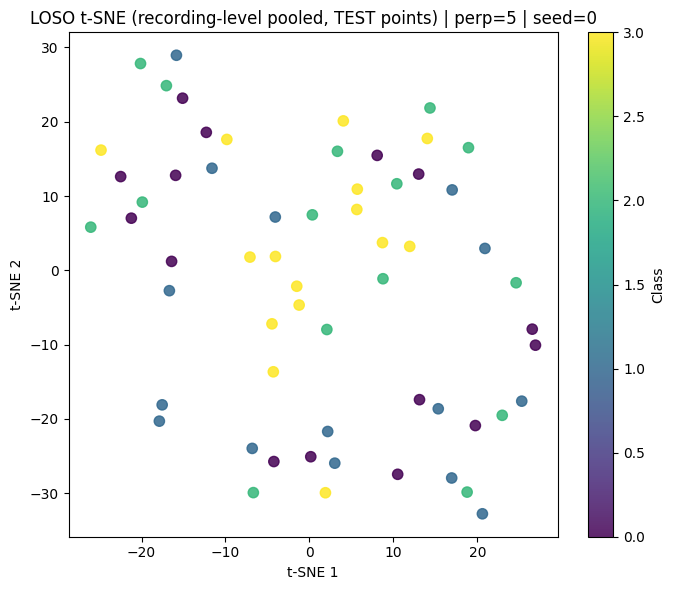

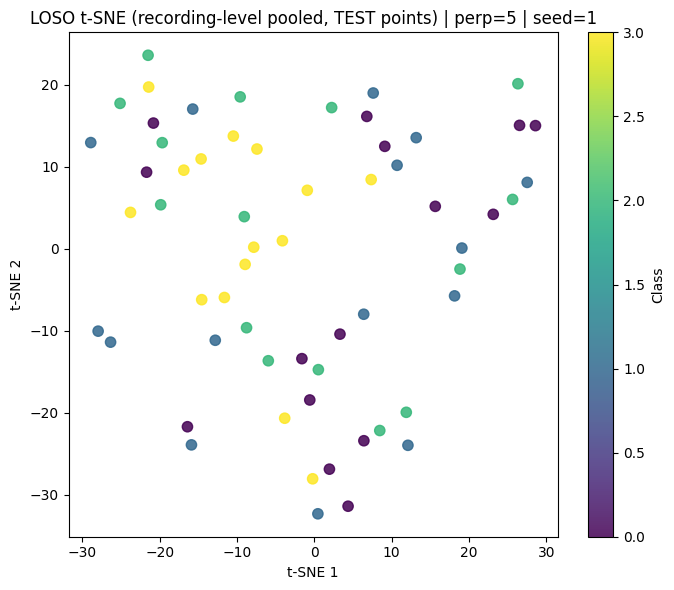

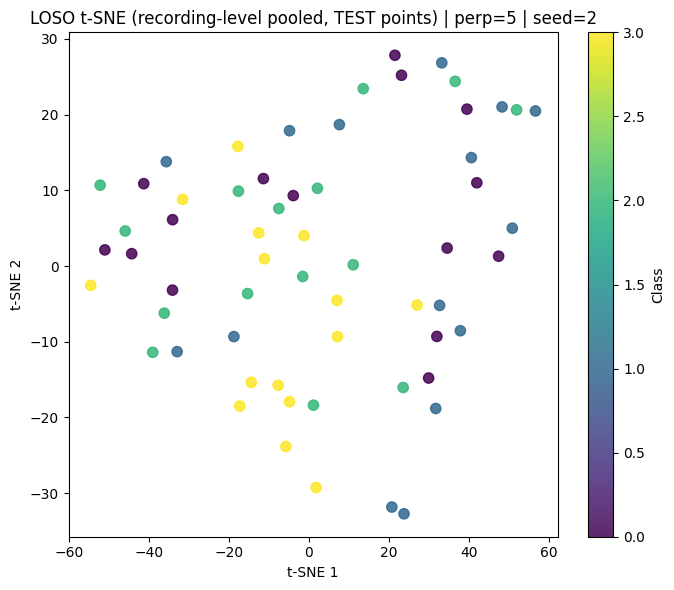

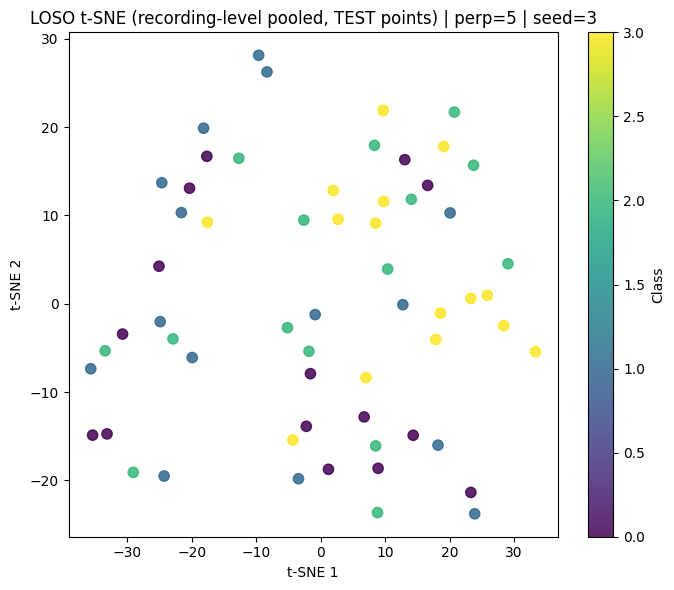

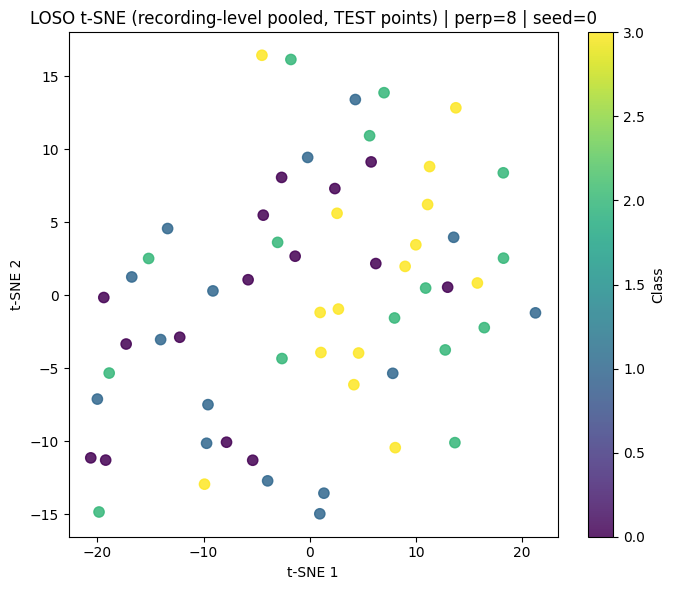

...

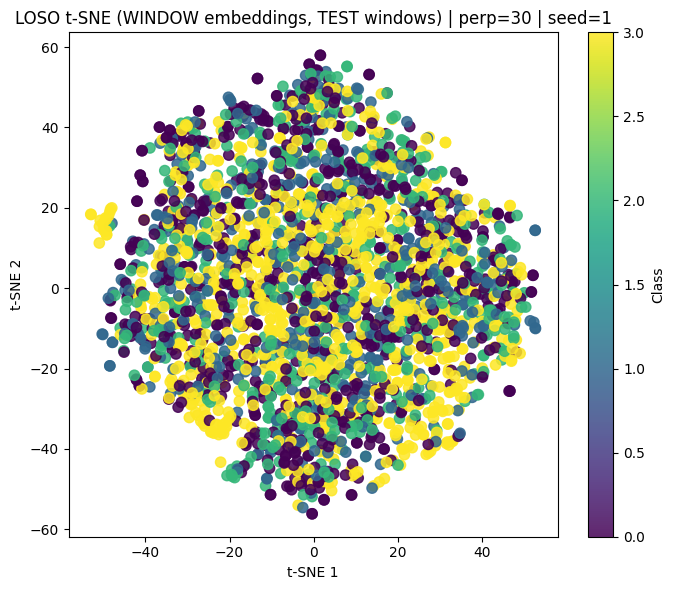

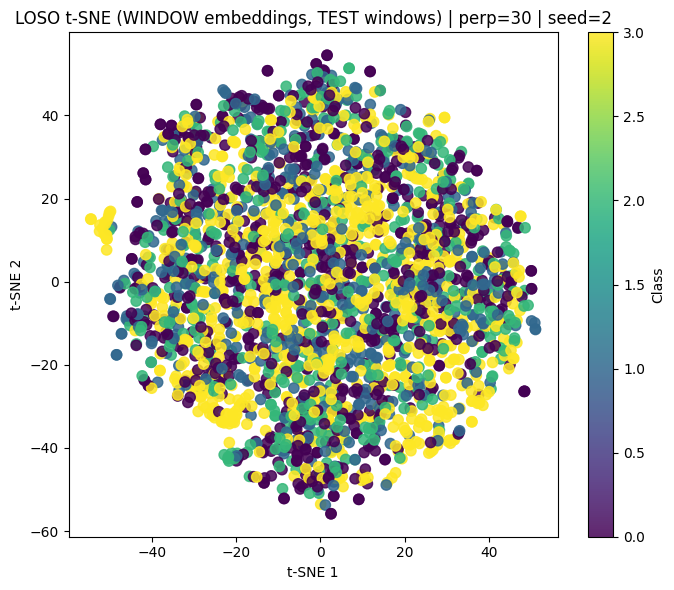

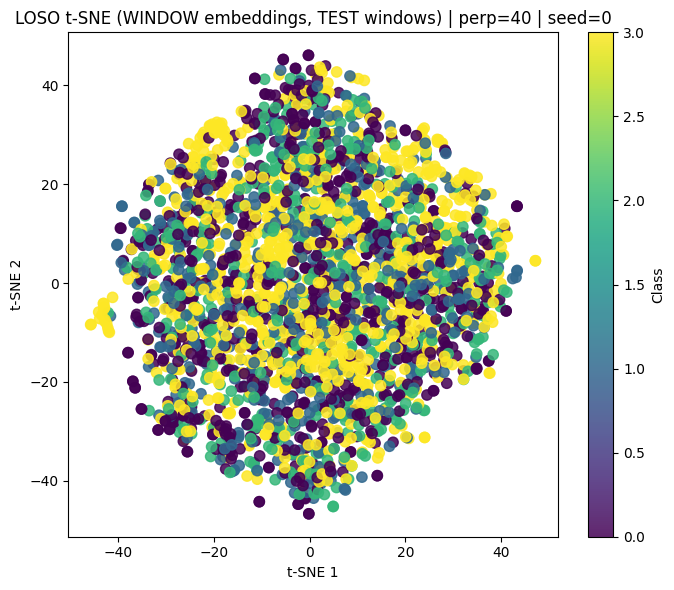

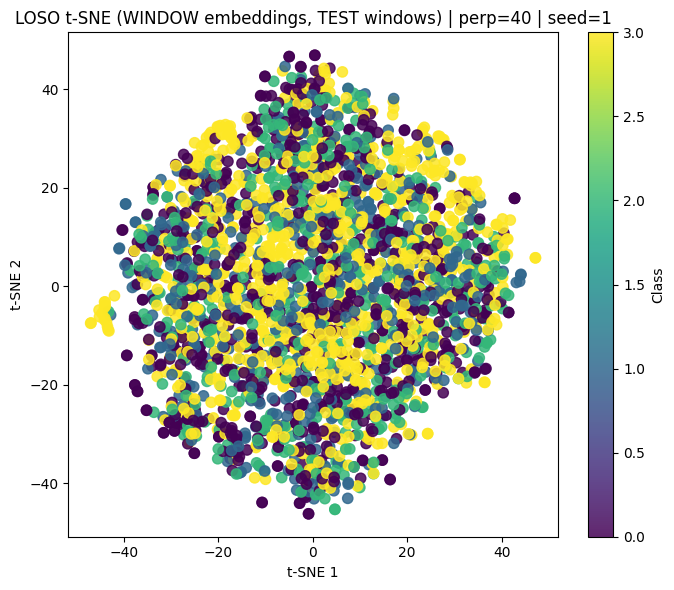

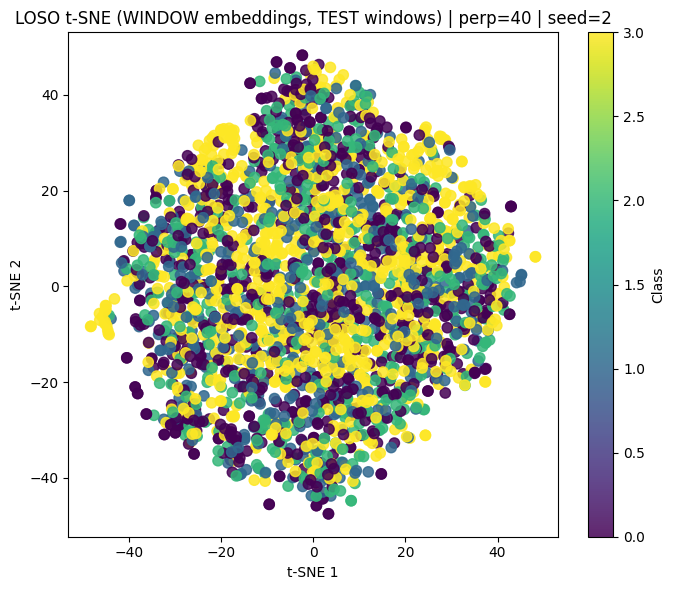

In [22]:
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
import matplotlib.pyplot as plt

from sklearn.model_selection import GroupShuffleSplit
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.metrics import (
    confusion_matrix,
    classification_report,
    balanced_accuracy_score,
    accuracy_score
)
from sklearn.metrics import balanced_accuracy_score

import torch.nn as nn

# =========================
# Utils
# =========================



def to_np(x):
    if isinstance(x, torch.Tensor):
        return x.detach().cpu().numpy()
    return np.asarray(x)

def to_str_np(x):
    return np.asarray(to_np(x)).astype(str).reshape(-1)


def pool_by_recording_torch(feat, y, rec):
    rec = np.asarray(rec).astype(str)
    uniq = np.unique(rec)
    Xr, Yr = [], []
    for rid in uniq:
        m = (rec == rid)
        Xr.append(feat[m].mean(dim=0))
        Yr.append(int(y[m][0].item()))
    return torch.stack(Xr, 0), torch.tensor(Yr, dtype=torch.long), uniq

# =========================
# MLP
# =========================
class MLP(nn.Module):
    def __init__(self, d_in, n_classes):
        super().__init__()
        self.net = nn.Sequential(
            nn.Linear(d_in, 256), nn.ReLU(), nn.Dropout(0.2),
            nn.Linear(256, 128), nn.ReLU(), nn.Dropout(0.2),
            nn.Linear(128, n_classes),
        )
    def forward(self, x):
        return self.net(x)

def train_mlp_with_val(Xtr_np, ytr_np, Xva_np, yva_np, num_classes, device,
                       max_epochs=300, patience=30, lr=1e-3, wd=1e-4, tau=1.0):

    Xtr = torch.tensor(Xtr_np, dtype=torch.float32).to(device)
    Xva = torch.tensor(Xva_np, dtype=torch.float32).to(device)
    ytr = torch.tensor(ytr_np, dtype=torch.long).to(device)
    yva = torch.tensor(yva_np, dtype=torch.long).to(device)

    clf = MLP(Xtr.shape[1], num_classes).to(device)

    counts = np.bincount(np.asarray(ytr_np).astype(int), minlength=num_classes)
    crit = LogitAdjustedCE(counts, tau=tau).to(device)


    opt  = optim.AdamW(clf.parameters(), lr=lr, weight_decay=wd)

    @torch.no_grad()
    def val_balacc():
        clf.eval()
        pred = clf(Xva).argmax(1).detach().cpu().numpy()
        true = yva.detach().cpu().numpy()
        return balanced_accuracy_score(true, pred)



    best, best_state, noimp = -1, None, 0
    for _ in range(max_epochs):
        clf.train()
        opt.zero_grad(set_to_none=True)
        loss = crit(clf(Xtr), ytr)
        loss.backward()
        opt.step()

        va = val_balacc()
        if va > best:
            best = va
            best_state = {k: v.detach().cpu().clone() for k, v in clf.state_dict().items()}
            noimp = 0
        else:
            noimp += 1
            if noimp >= patience:
                break

    if best_state is not None:
        clf.load_state_dict(best_state)
    return clf

# =========================
# Dataset (rec_id filter robust)
# =========================
from torch.utils.data import Dataset, DataLoader

class WindowDataset(Dataset):
    def __init__(self, X_all, y_all, rec_id_all, keep_rec_set):
        X_all = np.asarray(X_all)
        y_all = np.asarray(y_all)

        rec_id_all = np.asarray(rec_id_all).astype(str).reshape(-1)
        assert len(rec_id_all) == len(y_all) == X_all.shape[0], \
            f"Mismatch: rec_id={len(rec_id_all)} y={len(y_all)} X={X_all.shape}"

        mask = np.isin(rec_id_all, list(keep_rec_set))
        self.X = X_all[mask]
        self.y = y_all[mask]
        self.r = rec_id_all[mask]

    def __len__(self): return len(self.y)

    def __getitem__(self, i):
        return (torch.tensor(self.X[i], dtype=torch.float32),
                torch.tensor(self.y[i], dtype=torch.long),
                self.r[i])

# =========================
# t-SNE sweep utility
# =========================
def tsne_sweep(X_np, y_np, title_prefix, perplexities, seeds, pca_dim=30):
    X_np = np.asarray(X_np)
    y_np = np.asarray(y_np).astype(int).reshape(-1)
    assert len(X_np) == len(y_np)

    Xz = StandardScaler().fit_transform(X_np)
    k = min(pca_dim, Xz.shape[1])
    Xp = PCA(n_components=k, random_state=0).fit_transform(Xz)

    for perp in perplexities:
        if perp >= (len(Xp) - 1) / 3:   # regola pratica
            continue
        for seed in seeds:
            X2 = TSNE(
                n_components=2,
                perplexity=perp,
                init="pca",
                learning_rate="auto",
                random_state=seed
            ).fit_transform(Xp)

            plt.figure(figsize=(7,6))
            sc = plt.scatter(X2[:,0], X2[:,1], c=y_np, s=55, alpha=0.85)
            plt.colorbar(sc, label="Class")
            plt.title(f"{title_prefix} | perp={perp} | seed={seed}")
            plt.xlabel("t-SNE 1"); plt.ylabel("t-SNE 2")
            plt.tight_layout()
            plt.show()

# ============================================================
# LOSO MAIN (recording-level confusion + t-SNE)
# ============================================================
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
BATCH = 64

rec_ids_all = rec_id_win
subj_all = subj_win
subjects = np.unique(subj_all)

num_classes = int(np.max(y_all) + 1)

all_true, all_pred = [], []
all_true_win, all_pred_win = [], []

# per t-SNE LOSO recording-level: accumulo embedding test (pooled)
all_Xte_rec = []
all_yte_rec = []

# opzionale: per t-SNE LOSO windows: accumulo embedding window test (subsample)
DO_WINDOWS_TSNE = True
MAX_WIN_TSNE_PER_SUBJ = 500  # limita per subject per non esplodere
all_Xte_win = []
all_yte_win = []

rec_id_win = meta["rec_id"].astype(str)
subj_win   = meta["subject"].astype(str)


rec_ids = np.unique(rec_id_win)
rec_ids_all = rec_id_win
subj_all = subj_win
subjects = np.unique(subj_all)


# mappa recording -> subject (prendo il subject della prima finestra di quel recording)
rec_to_subj = {}
for rid in rec_ids:
    idx = np.where(rec_id_win == rid)[0][0]
    rec_to_subj[rid] = subj_win[idx]


for s in subjects:
    # TEST: tutti i recording del subject s
    test_rec = set(np.unique(rec_ids_all[subj_all == s]))

    # TRAINVAL: recording degli altri subject
    trainval_rec = np.unique(rec_ids_all[subj_all != s])

    # split train/val sui recording, grouped by subject
    trainval_subj = np.array([rec_to_subj[rid] for rid in trainval_rec])
    gss = GroupShuffleSplit(n_splits=1, test_size=0.2, random_state=42)
    tr_idx, va_idx = next(gss.split(trainval_rec, groups=trainval_subj))
    train_rec = set(trainval_rec[tr_idx])
    val_rec   = set(trainval_rec[va_idx])

    # loaders (WINDOW level)
    train_ds = WindowDataset(X_all, y_all, rec_ids_all, train_rec)
    val_ds   = WindowDataset(X_all, y_all, rec_ids_all, val_rec)
    test_ds  = WindowDataset(X_all, y_all, rec_ids_all, test_rec)

    train_loader = DataLoader(train_ds, batch_size=BATCH, shuffle=False)
    val_loader   = DataLoader(val_ds,   batch_size=BATCH, shuffle=False)
    test_loader  = DataLoader(test_ds,  batch_size=BATCH, shuffle=False)

    # EEGPT features window-level
    tr_feat, tr_y, tr_rec = extract_eegpt_features(model, train_loader, device, chan_ids_8)
    va_feat, va_y, va_rec = extract_eegpt_features(model, val_loader,   device, chan_ids_8)
    te_feat, te_y, te_rec = extract_eegpt_features(model, test_loader,  device, chan_ids_8)

    # =========================
    # WINDOW-LEVEL classifier (senza pooling)
    # =========================
    scaler_w = StandardScaler()
    Xtr_w_np = scaler_w.fit_transform(to_np(tr_feat))
    Xva_w_np = scaler_w.transform(to_np(va_feat))
    Xte_w_np = scaler_w.transform(to_np(te_feat))

    clf_w = train_mlp_with_val(
        Xtr_w_np, to_np(tr_y),
        Xva_w_np, to_np(va_y),
        num_classes=num_classes,
        device=device
    )

    with torch.no_grad():
        clf_w.eval()
        te_pred_w = clf_w(torch.tensor(Xte_w_np, dtype=torch.float32).to(device)).argmax(1).cpu().numpy()

    all_true_win.extend(to_np(te_y).tolist())
    all_pred_win.extend(te_pred_w.tolist())


    # pool recording-level
    X_tr, y_tr, _ = pool_by_recording_torch(tr_feat, tr_y, tr_rec)
    X_va, y_va, _ = pool_by_recording_torch(va_feat, va_y, va_rec)
    X_te, y_te, _ = pool_by_recording_torch(te_feat, te_y, te_rec)

    # scaler fit SOLO train
    scaler = StandardScaler()
    X_tr_np = scaler.fit_transform(to_np(X_tr))
    X_va_np = scaler.transform(to_np(X_va))
    X_te_np = scaler.transform(to_np(X_te))

    # train clf
    clf = train_mlp_with_val(
        X_tr_np, to_np(y_tr),
        X_va_np, to_np(y_va),
        num_classes=num_classes,
        device=device
    )

    # predict test recording-level
    with torch.no_grad():
        clf.eval()
        te_pred = clf(torch.tensor(X_te_np, dtype=torch.float32).to(device)).argmax(1).cpu().numpy()

    # accumulate confusion matrix LOSO
    all_true.extend(to_np(y_te).tolist())
    all_pred.extend(te_pred.tolist())

    # accumulate for t-SNE LOSO (recording-level)
    all_Xte_rec.append(X_te_np)
    all_yte_rec.append(to_np(y_te))

    # OPTIONAL: accumulate windows for t-SNE (subsample per subject)
    if DO_WINDOWS_TSNE:
        Xw = to_np(te_feat)         # (Nwin_test, D)
        yw = to_np(te_y)            # (Nwin_test,)
        if len(Xw) > MAX_WIN_TSNE_PER_SUBJ:
            rs = np.random.RandomState(0)
            idx = rs.choice(len(Xw), size=MAX_WIN_TSNE_PER_SUBJ, replace=False)
            Xw = Xw[idx]
            yw = yw[idx]
        all_Xte_win.append(Xw)
        all_yte_win.append(yw)

# ---- FINAL LOSO confusion matrix
cm = confusion_matrix(all_true, all_pred, labels=list(range(num_classes)))
print("LOSO Confusion matrix:\n", cm)
print("\nLOSO Report:\n", classification_report(all_true, all_pred, digits=3))

print("\n==============================")
print("LOSO WINDOW-LEVEL")
print("==============================")
print("Balanced Accuracy:", balanced_accuracy_score(all_true_win, all_pred_win))
print("Accuracy:", accuracy_score(all_true_win, all_pred_win))
cm_w = confusion_matrix(all_true_win, all_pred_win, labels=list(range(num_classes)))
print("Confusion matrix:\n", cm_w)
print("\nReport:\n", classification_report(all_true_win, all_pred_win, digits=3))


# ---- FINAL LOSO t-SNE (recording-level pooled test points)
X_tsne_rec = np.concatenate(all_Xte_rec, axis=0)   # ~60 x 512
y_tsne_rec = np.concatenate(all_yte_rec, axis=0)   # ~60

tsne_sweep(
    X_tsne_rec, y_tsne_rec,
    title_prefix="LOSO t-SNE (recording-level pooled, TEST points)",
    perplexities=(5, 8, 10, 12, 15),
    seeds=(0, 1, 2, 3),
    pca_dim=30
)

# ---- OPTIONAL: LOSO t-SNE windows (TEST windows across all LOSO iters)
if DO_WINDOWS_TSNE:
    X_tsne_win = np.concatenate(all_Xte_win, axis=0)
    y_tsne_win = np.concatenate(all_yte_win, axis=0)

    # per windows puoi usare perplexity più alta
    tsne_sweep(
        X_tsne_win, y_tsne_win,
        title_prefix="LOSO t-SNE (WINDOW embeddings, TEST windows)",
        perplexities=(10, 15, 20, 30, 40),
        seeds=(0, 1, 2),
        pca_dim=30
    )


### senza nulla

LOSO Confusion matrix:
 [[2 6 5 2]
 [6 4 4 1]
 [4 5 5 1]
 [3 3 2 7]]

LOSO Report:
               precision    recall  f1-score   support

           0      0.133     0.133     0.133        15
           1      0.222     0.267     0.242        15
           2      0.312     0.333     0.323        15
           3      0.636     0.467     0.538        15

    accuracy                          0.300        60
   macro avg      0.326     0.300     0.309        60
weighted avg      0.326     0.300     0.309        60


LOSO WINDOW-LEVEL
Balanced Accuracy: 0.3288542249693042
Accuracy: 0.40476190476190477
Confusion matrix:
 [[472  22  26 224]
 [246  10  22 181]
 [281  12  17 172]
 [268  21  25 521]]

Report:
               precision    recall  f1-score   support

           0      0.373     0.634     0.469       744
           1      0.154     0.022     0.038       459
           2      0.189     0.035     0.059       482
           3      0.474     0.624     0.539       835

    accuracy    

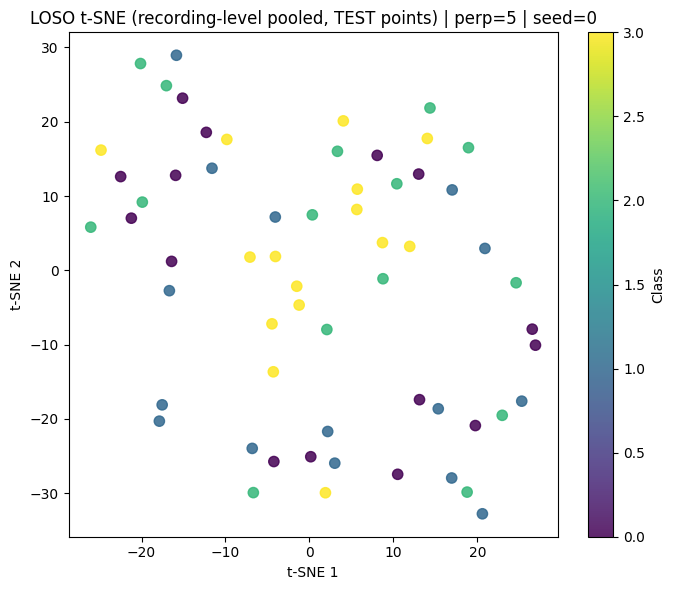

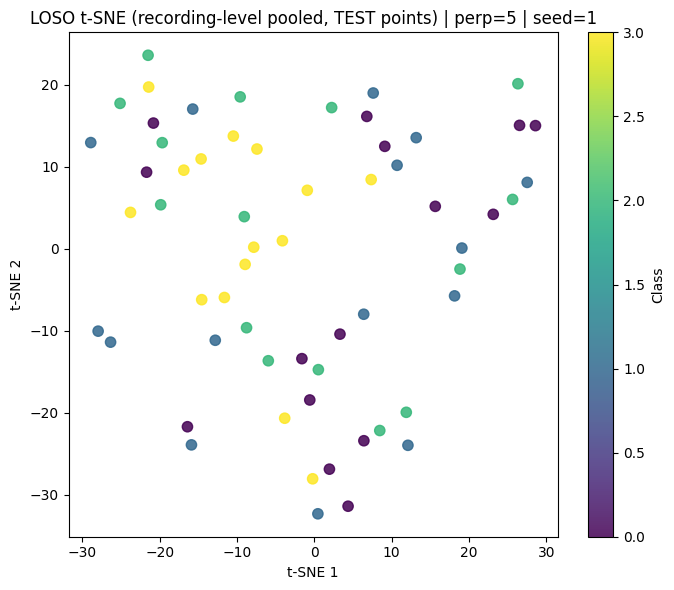

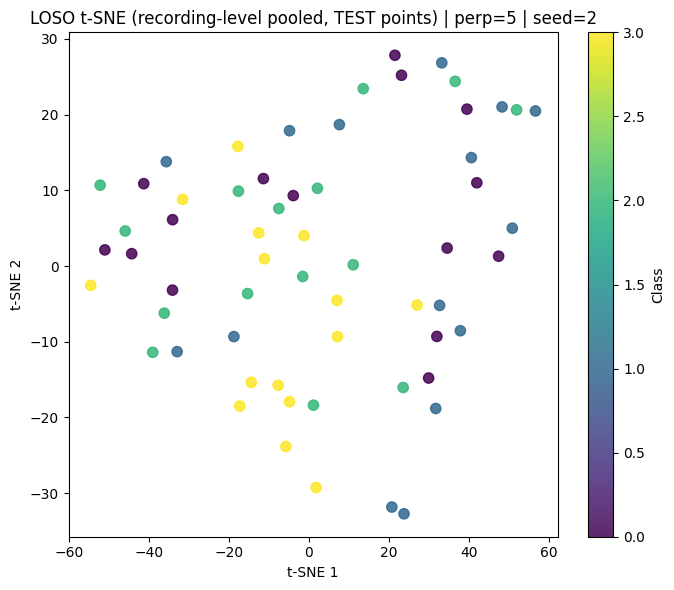

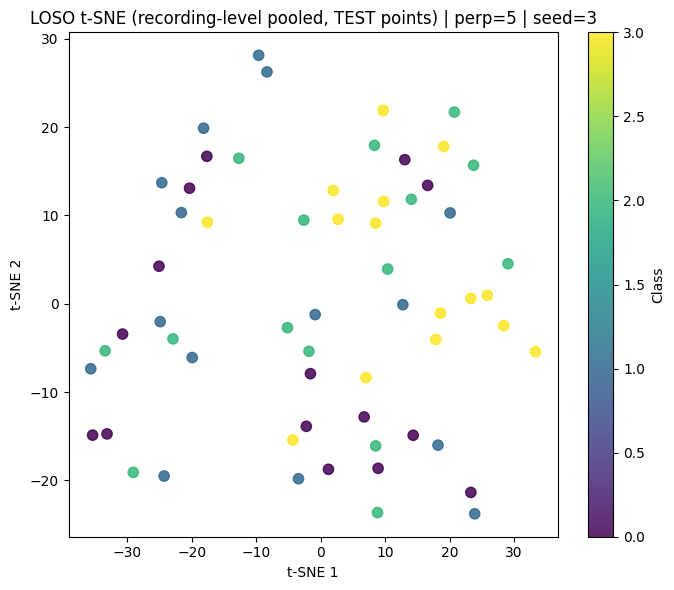

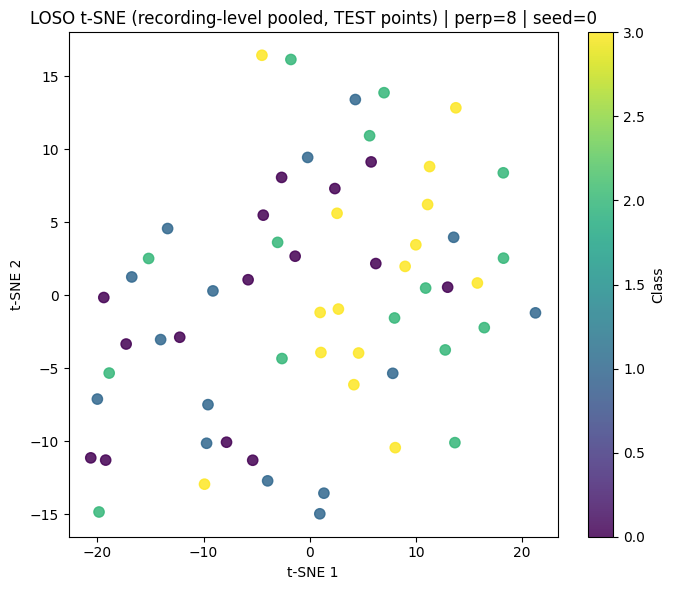

...

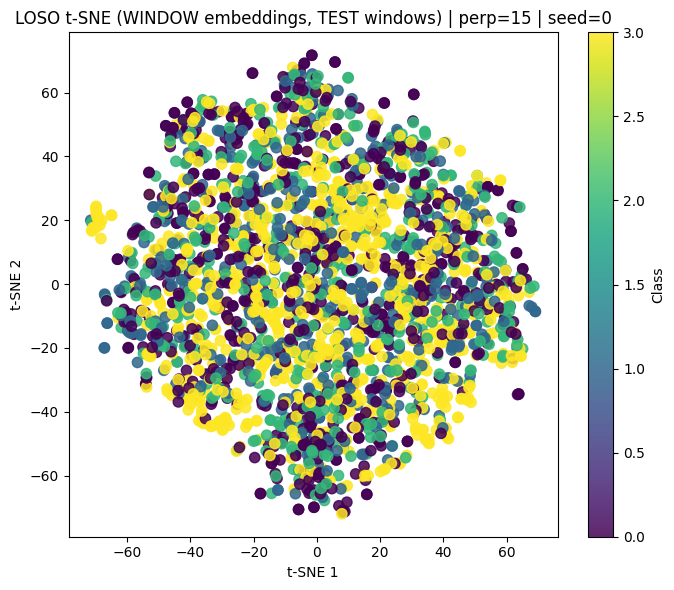

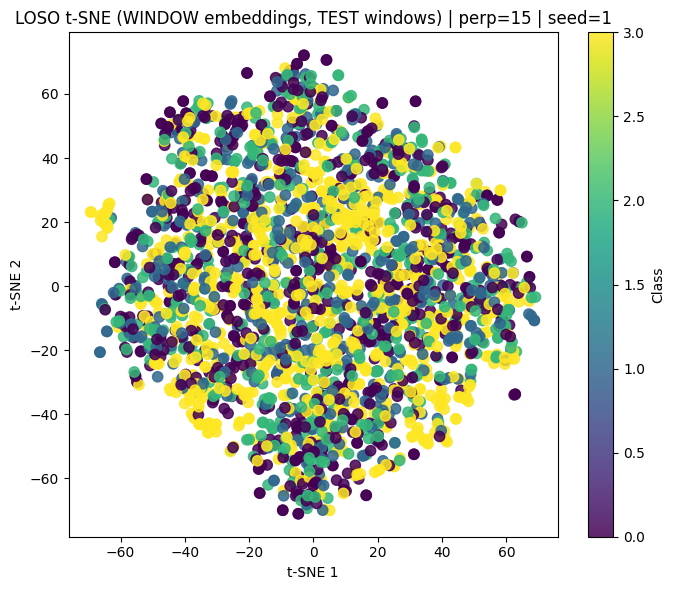

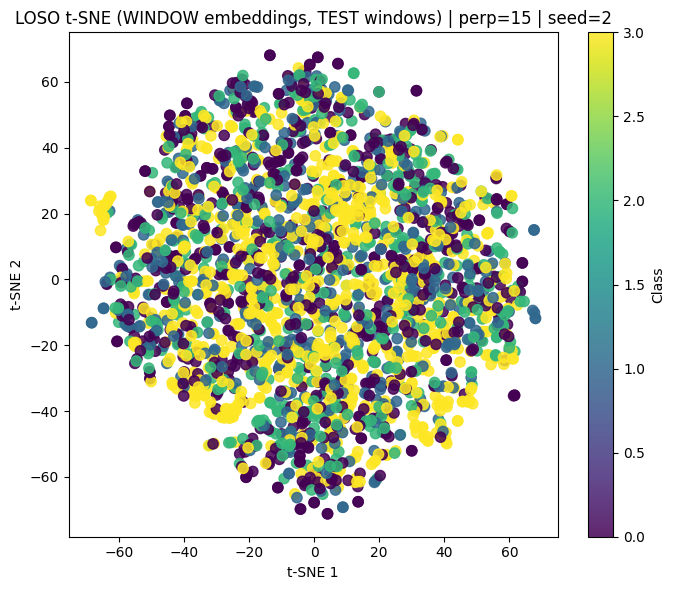

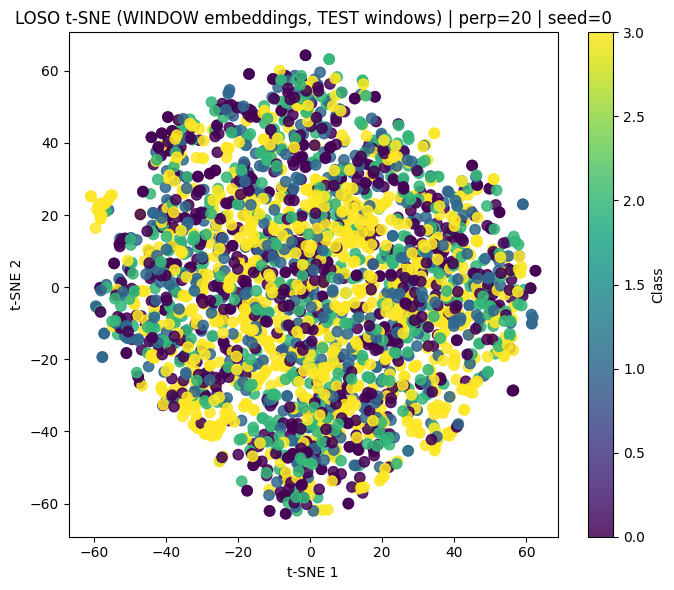

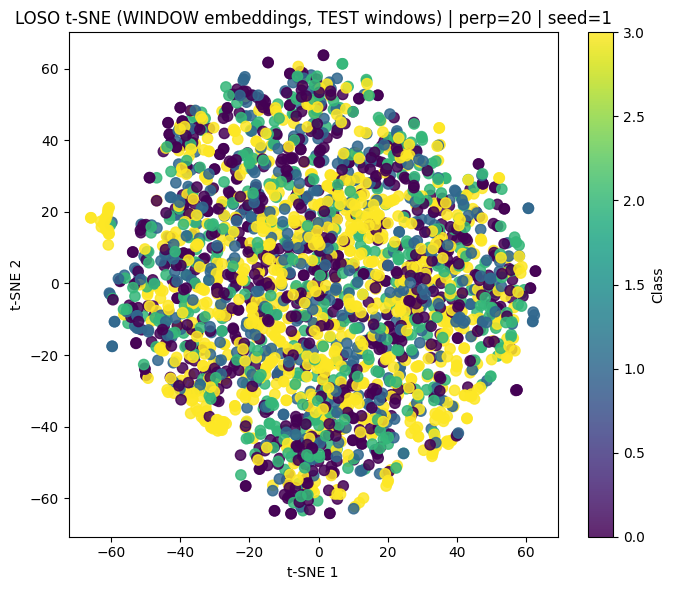

KeyboardInterrupt: 

In [18]:
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
import matplotlib.pyplot as plt

from sklearn.model_selection import GroupShuffleSplit
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.metrics import (
    confusion_matrix,
    classification_report,
    balanced_accuracy_score,
    accuracy_score
)


# =========================
# Utils
# =========================
def to_np(x):
    if isinstance(x, torch.Tensor):
        return x.detach().cpu().numpy()
    return np.asarray(x)

def to_str_np(x):
    return np.asarray(to_np(x)).astype(str).reshape(-1)


def pool_by_recording_torch(feat, y, rec):
    rec = np.asarray(rec).astype(str)
    uniq = np.unique(rec)
    Xr, Yr = [], []
    for rid in uniq:
        m = (rec == rid)
        Xr.append(feat[m].mean(dim=0))
        Yr.append(int(y[m][0].item()))
    return torch.stack(Xr, 0), torch.tensor(Yr, dtype=torch.long), uniq

# =========================
# MLP
# =========================
class MLP(nn.Module):
    def __init__(self, d_in, n_classes):
        super().__init__()
        self.net = nn.Sequential(
            nn.Linear(d_in, 256), nn.ReLU(), nn.Dropout(0.2),
            nn.Linear(256, 128), nn.ReLU(), nn.Dropout(0.2),
            nn.Linear(128, n_classes),
        )
    def forward(self, x):
        return self.net(x)

def train_mlp_with_val(Xtr_np, ytr_np, Xva_np, yva_np, num_classes, device,
                       max_epochs=300, patience=30, lr=1e-3, wd=1e-4):
    Xtr = torch.tensor(Xtr_np, dtype=torch.float32).to(device)
    Xva = torch.tensor(Xva_np, dtype=torch.float32).to(device)
    ytr = torch.tensor(ytr_np, dtype=torch.long).to(device)
    yva = torch.tensor(yva_np, dtype=torch.long).to(device)

    clf = MLP(Xtr.shape[1], num_classes).to(device)
    crit = nn.CrossEntropyLoss()
    opt  = optim.AdamW(clf.parameters(), lr=lr, weight_decay=wd)

    @torch.no_grad()
    def val_acc():
        clf.eval()
        pred = clf(Xva).argmax(1)
        return (pred == yva).float().mean().item()

    best, best_state, noimp = -1, None, 0
    for _ in range(max_epochs):
        clf.train()
        opt.zero_grad(set_to_none=True)
        loss = crit(clf(Xtr), ytr)
        loss.backward()
        opt.step()

        va = val_acc()
        if va > best:
            best = va
            best_state = {k: v.detach().cpu().clone() for k, v in clf.state_dict().items()}
            noimp = 0
        else:
            noimp += 1
            if noimp >= patience:
                break

    if best_state is not None:
        clf.load_state_dict(best_state)
    return clf

# =========================
# Dataset (rec_id filter robust)
# =========================
from torch.utils.data import Dataset, DataLoader

class WindowDataset(Dataset):
    def __init__(self, X_all, y_all, rec_id_all, keep_rec_set):
        X_all = np.asarray(X_all)
        y_all = np.asarray(y_all)

        rec_id_all = np.asarray(rec_id_all).astype(str).reshape(-1)
        assert len(rec_id_all) == len(y_all) == X_all.shape[0], \
            f"Mismatch: rec_id={len(rec_id_all)} y={len(y_all)} X={X_all.shape}"

        mask = np.isin(rec_id_all, list(keep_rec_set))
        self.X = X_all[mask]
        self.y = y_all[mask]
        self.r = rec_id_all[mask]

    def __len__(self): return len(self.y)

    def __getitem__(self, i):
        return (torch.tensor(self.X[i], dtype=torch.float32),
                torch.tensor(self.y[i], dtype=torch.long),
                self.r[i])

# =========================
# t-SNE sweep utility
# =========================
def tsne_sweep(X_np, y_np, title_prefix, perplexities, seeds, pca_dim=30):
    X_np = np.asarray(X_np)
    y_np = np.asarray(y_np).astype(int).reshape(-1)
    assert len(X_np) == len(y_np)

    Xz = StandardScaler().fit_transform(X_np)
    k = min(pca_dim, Xz.shape[1])
    Xp = PCA(n_components=k, random_state=0).fit_transform(Xz)

    for perp in perplexities:
        if perp >= (len(Xp) - 1) / 3:   # regola pratica
            continue
        for seed in seeds:
            X2 = TSNE(
                n_components=2,
                perplexity=perp,
                init="pca",
                learning_rate="auto",
                random_state=seed
            ).fit_transform(Xp)

            plt.figure(figsize=(7,6))
            sc = plt.scatter(X2[:,0], X2[:,1], c=y_np, s=55, alpha=0.85)
            plt.colorbar(sc, label="Class")
            plt.title(f"{title_prefix} | perp={perp} | seed={seed}")
            plt.xlabel("t-SNE 1"); plt.ylabel("t-SNE 2")
            plt.tight_layout()
            plt.show()

# ============================================================
# LOSO MAIN (recording-level confusion + t-SNE)
# ============================================================
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
BATCH = 64

rec_ids_all = rec_id_win
subj_all = subj_win
subjects = np.unique(subj_all)

num_classes = int(np.max(y_all) + 1)

all_true, all_pred = [], []
all_true_win, all_pred_win = [], []

# per t-SNE LOSO recording-level: accumulo embedding test (pooled)
all_Xte_rec = []
all_yte_rec = []

# opzionale: per t-SNE LOSO windows: accumulo embedding window test (subsample)
DO_WINDOWS_TSNE = True
MAX_WIN_TSNE_PER_SUBJ = 500  # limita per subject per non esplodere
all_Xte_win = []
all_yte_win = []

rec_id_win = meta["rec_id"].astype(str)
subj_win   = meta["subject"].astype(str)


rec_ids = np.unique(rec_id_win)
rec_ids_all = rec_id_win
subj_all = subj_win
subjects = np.unique(subj_all)


# mappa recording -> subject (prendo il subject della prima finestra di quel recording)
rec_to_subj = {}
for rid in rec_ids:
    idx = np.where(rec_id_win == rid)[0][0]
    rec_to_subj[rid] = subj_win[idx]


for s in subjects:
    # TEST: tutti i recording del subject s
    test_rec = set(np.unique(rec_ids_all[subj_all == s]))

    # TRAINVAL: recording degli altri subject
    trainval_rec = np.unique(rec_ids_all[subj_all != s])

    # split train/val sui recording, grouped by subject
    trainval_subj = np.array([rec_to_subj[rid] for rid in trainval_rec])
    gss = GroupShuffleSplit(n_splits=1, test_size=0.2, random_state=42)
    tr_idx, va_idx = next(gss.split(trainval_rec, groups=trainval_subj))
    train_rec = set(trainval_rec[tr_idx])
    val_rec   = set(trainval_rec[va_idx])

    # loaders (WINDOW level)
    train_ds = WindowDataset(X_all, y_all, rec_ids_all, train_rec)
    val_ds   = WindowDataset(X_all, y_all, rec_ids_all, val_rec)
    test_ds  = WindowDataset(X_all, y_all, rec_ids_all, test_rec)

    train_loader = DataLoader(train_ds, batch_size=BATCH, shuffle=False)
    val_loader   = DataLoader(val_ds,   batch_size=BATCH, shuffle=False)
    test_loader  = DataLoader(test_ds,  batch_size=BATCH, shuffle=False)

    # EEGPT features window-level
    tr_feat, tr_y, tr_rec = extract_eegpt_features(model, train_loader, device, chan_ids_8)
    va_feat, va_y, va_rec = extract_eegpt_features(model, val_loader,   device, chan_ids_8)
    te_feat, te_y, te_rec = extract_eegpt_features(model, test_loader,  device, chan_ids_8)

    # =========================
    # WINDOW-LEVEL classifier (senza pooling)
    # =========================
    scaler_w = StandardScaler()
    Xtr_w_np = scaler_w.fit_transform(to_np(tr_feat))
    Xva_w_np = scaler_w.transform(to_np(va_feat))
    Xte_w_np = scaler_w.transform(to_np(te_feat))

    clf_w = train_mlp_with_val(
        Xtr_w_np, to_np(tr_y),
        Xva_w_np, to_np(va_y),
        num_classes=num_classes,
        device=device
    )

    with torch.no_grad():
        clf_w.eval()
        te_pred_w = clf_w(torch.tensor(Xte_w_np, dtype=torch.float32).to(device)).argmax(1).cpu().numpy()

    all_true_win.extend(to_np(te_y).tolist())
    all_pred_win.extend(te_pred_w.tolist())


    # pool recording-level
    X_tr, y_tr, _ = pool_by_recording_torch(tr_feat, tr_y, tr_rec)
    X_va, y_va, _ = pool_by_recording_torch(va_feat, va_y, va_rec)
    X_te, y_te, _ = pool_by_recording_torch(te_feat, te_y, te_rec)

    # scaler fit SOLO train
    scaler = StandardScaler()
    X_tr_np = scaler.fit_transform(to_np(X_tr))
    X_va_np = scaler.transform(to_np(X_va))
    X_te_np = scaler.transform(to_np(X_te))

    # train clf
    clf = train_mlp_with_val(
        X_tr_np, to_np(y_tr),
        X_va_np, to_np(y_va),
        num_classes=num_classes,
        device=device
    )

    # predict test recording-level
    with torch.no_grad():
        clf.eval()
        te_pred = clf(torch.tensor(X_te_np, dtype=torch.float32).to(device)).argmax(1).cpu().numpy()

    # accumulate confusion matrix LOSO
    all_true.extend(to_np(y_te).tolist())
    all_pred.extend(te_pred.tolist())

    # accumulate for t-SNE LOSO (recording-level)
    all_Xte_rec.append(X_te_np)
    all_yte_rec.append(to_np(y_te))

    # OPTIONAL: accumulate windows for t-SNE (subsample per subject)
    if DO_WINDOWS_TSNE:
        Xw = to_np(te_feat)         # (Nwin_test, D)
        yw = to_np(te_y)            # (Nwin_test,)
        if len(Xw) > MAX_WIN_TSNE_PER_SUBJ:
            rs = np.random.RandomState(0)
            idx = rs.choice(len(Xw), size=MAX_WIN_TSNE_PER_SUBJ, replace=False)
            Xw = Xw[idx]
            yw = yw[idx]
        all_Xte_win.append(Xw)
        all_yte_win.append(yw)

# ---- FINAL LOSO confusion matrix
cm = confusion_matrix(all_true, all_pred, labels=list(range(num_classes)))
print("LOSO Confusion matrix:\n", cm)
print("\nLOSO Report:\n", classification_report(all_true, all_pred, digits=3))

print("\n==============================")
print("LOSO WINDOW-LEVEL")
print("==============================")
print("Balanced Accuracy:", balanced_accuracy_score(all_true_win, all_pred_win))
print("Accuracy:", accuracy_score(all_true_win, all_pred_win))
cm_w = confusion_matrix(all_true_win, all_pred_win, labels=list(range(num_classes)))
print("Confusion matrix:\n", cm_w)
print("\nReport:\n", classification_report(all_true_win, all_pred_win, digits=3))


# ---- FINAL LOSO t-SNE (recording-level pooled test points)
X_tsne_rec = np.concatenate(all_Xte_rec, axis=0)   # ~60 x 512
y_tsne_rec = np.concatenate(all_yte_rec, axis=0)   # ~60

tsne_sweep(
    X_tsne_rec, y_tsne_rec,
    title_prefix="LOSO t-SNE (recording-level pooled, TEST points)",
    perplexities=(5, 8, 10, 12, 15),
    seeds=(0, 1, 2, 3),
    pca_dim=30
)

# ---- OPTIONAL: LOSO t-SNE windows (TEST windows across all LOSO iters)
if DO_WINDOWS_TSNE:
    X_tsne_win = np.concatenate(all_Xte_win, axis=0)
    y_tsne_win = np.concatenate(all_yte_win, axis=0)

    # per windows puoi usare perplexity più alta
    tsne_sweep(
        X_tsne_win, y_tsne_win,
        title_prefix="LOSO t-SNE (WINDOW embeddings, TEST windows)",
        perplexities=(10, 15, 20, 30, 40),
        seeds=(0, 1, 2),
        pca_dim=30
    )


### cambiando pooling

In [17]:
import numpy as np

def aggregate_recording_pred_from_window_probs(probs, y_win, rec_ids, mode="mean"):
    """
    probs:   (Nwin, C) numpy array (softmax per finestra)
    y_win:   (Nwin,) numpy/int labels per finestra (uguali dentro recording)
    rec_ids: (Nwin,) array-like id recording per finestra (string o int)
    mode:    "mean" | "logsum" | "vote"
    returns:
      y_true_rec: (Nrec,)
      y_pred_rec: (Nrec,)
      rec_uniq:   (Nrec,)
    """
    probs = np.asarray(probs)
    y_win = np.asarray(y_win).astype(int).reshape(-1)
    rec_ids = np.asarray(rec_ids).astype(str).reshape(-1)

    rec_uniq = np.unique(rec_ids)
    y_true_rec = []
    y_pred_rec = []

    for rid in rec_uniq:
        m = (rec_ids == rid)
        p = probs[m]          # (n_i, C)
        y0 = y_win[m][0]      # label vera del recording (assunta costante)

        if mode == "mean":
            p_agg = p.mean(axis=0)
            yhat = int(np.argmax(p_agg))

        elif mode == "logsum":
            # somma dei log -> più robusto a finestre "sicure"
            s = np.log(p + 1e-12).sum(axis=0)
            yhat = int(np.argmax(s))

        elif mode == "vote":
            # majority vote su argmax finestra
            votes = np.argmax(p, axis=1)
            yhat = int(np.bincount(votes, minlength=p.shape[1]).argmax())

        else:
            raise ValueError("mode deve essere: 'mean', 'logsum' o 'vote'")

        y_true_rec.append(int(y0))
        y_pred_rec.append(yhat)

    return np.array(y_true_rec), np.array(y_pred_rec), rec_uniq


In [21]:
def build_recording_embeddings_for_plot(feat_np, y_np, rec_ids):
    rec_ids = np.asarray(rec_ids).astype(str).reshape(-1)
    y_np = np.asarray(y_np).astype(int).reshape(-1)
    feat_np = np.asarray(feat_np)

    uniq = np.unique(rec_ids)
    Xr, Yr = [], []
    for rid in uniq:
        m = (rec_ids == rid)
        Xr.append(feat_np[m].mean(axis=0))
        Yr.append(int(y_np[m][0]))
    return np.stack(Xr, axis=0), np.array(Yr), uniq



LOSO Confusion matrix:
 [[12  1  1  1]
 [ 3  2  3  7]
 [ 3  3  4  5]
 [ 2  4  2  7]]

LOSO Report:
               precision    recall  f1-score   support

           0      0.600     0.800     0.686        15
           1      0.200     0.133     0.160        15
           2      0.400     0.267     0.320        15
           3      0.350     0.467     0.400        15

    accuracy                          0.417        60
   macro avg      0.388     0.417     0.391        60
weighted avg      0.388     0.417     0.391        60


LOSO WINDOW-LEVEL
Balanced Accuracy: 0.33428921954535984
Accuracy: 0.3626984126984127
Confusion matrix:
 [[420 138 166 111]
 [114 105 126 137]
 [103 115 112 129]
 [118 169 180 277]]

Report:
               precision    recall  f1-score   support

           0      0.556     0.503     0.528       835
           1      0.199     0.218     0.208       482
           2      0.192     0.244     0.215       459
           3      0.424     0.372     0.396       744



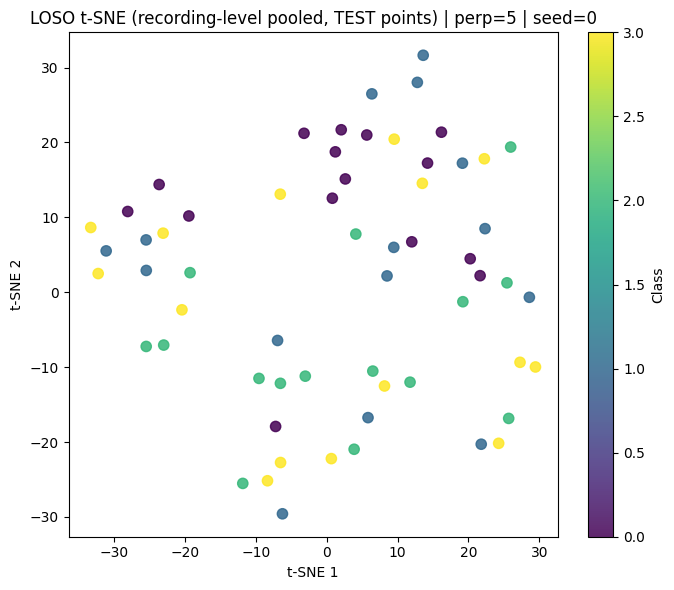

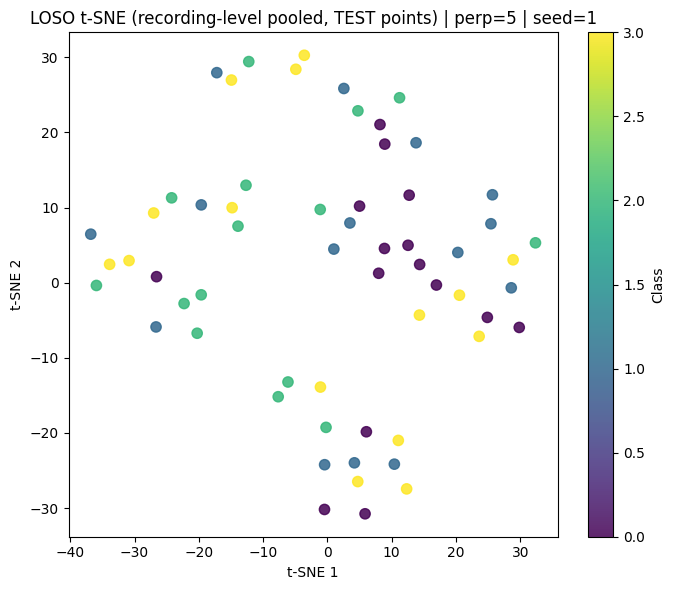

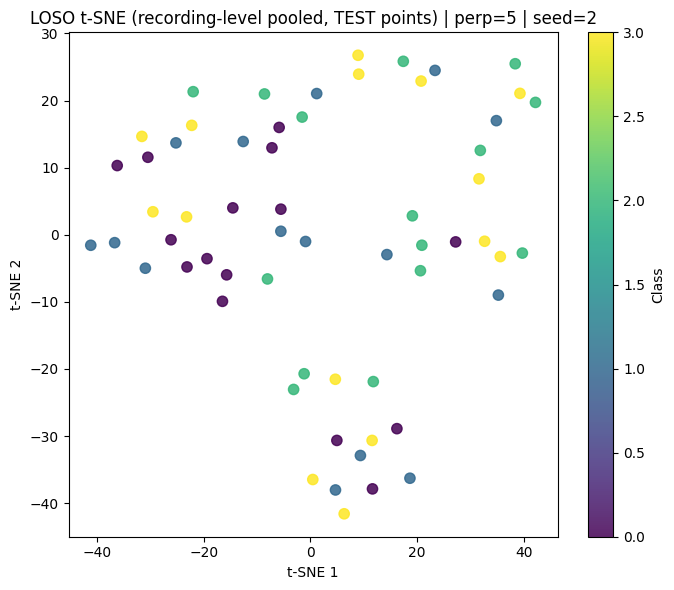

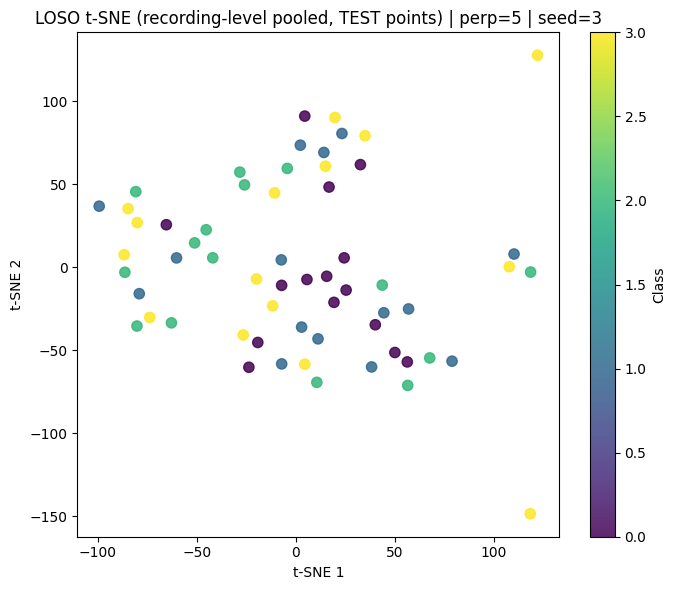

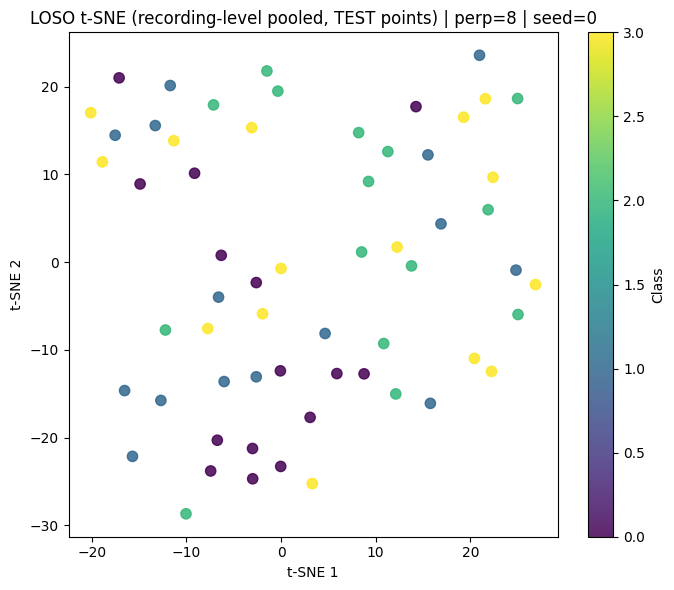

...

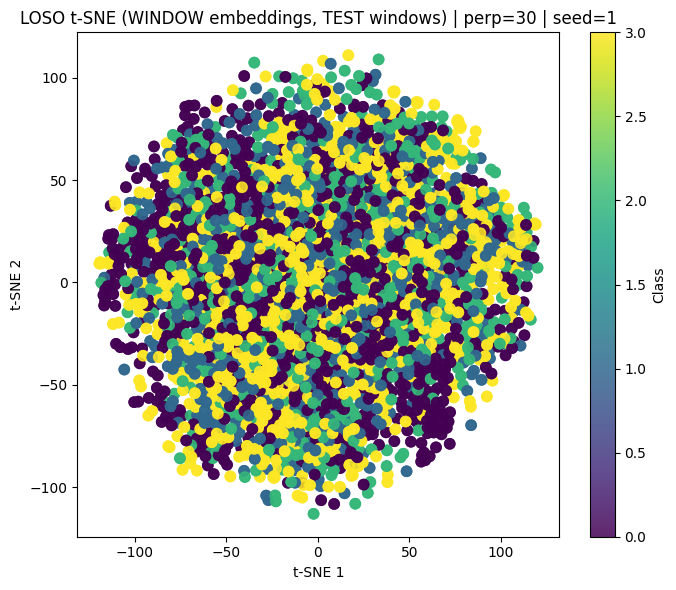

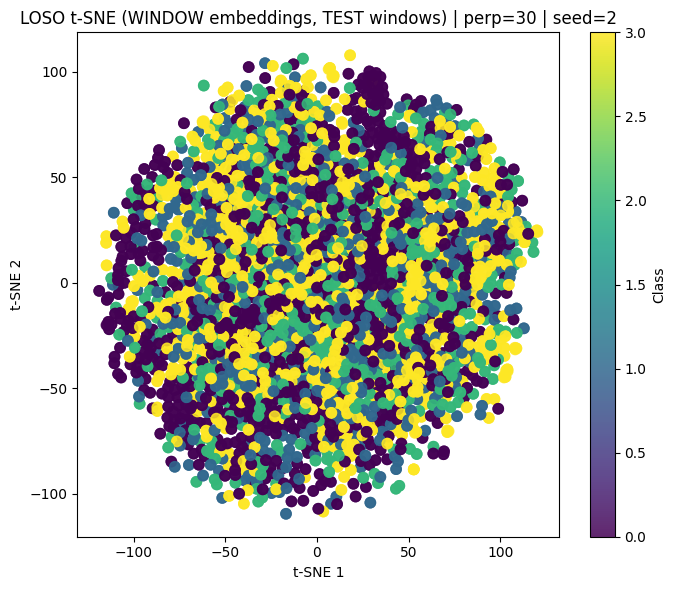

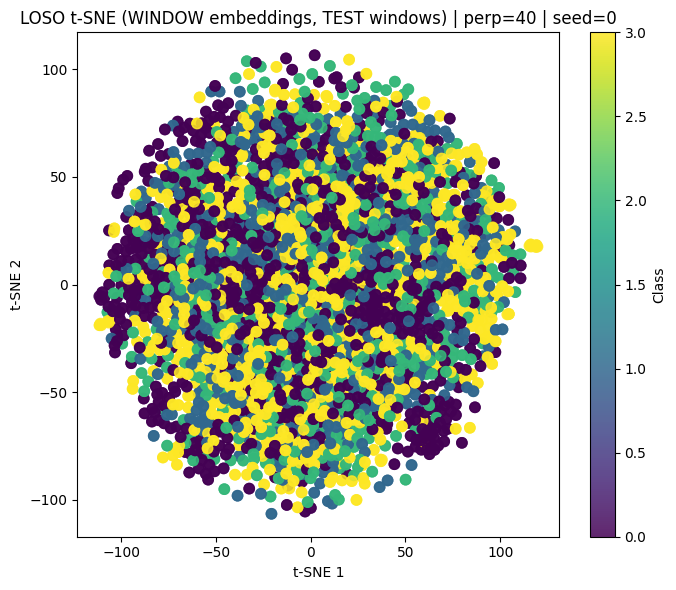

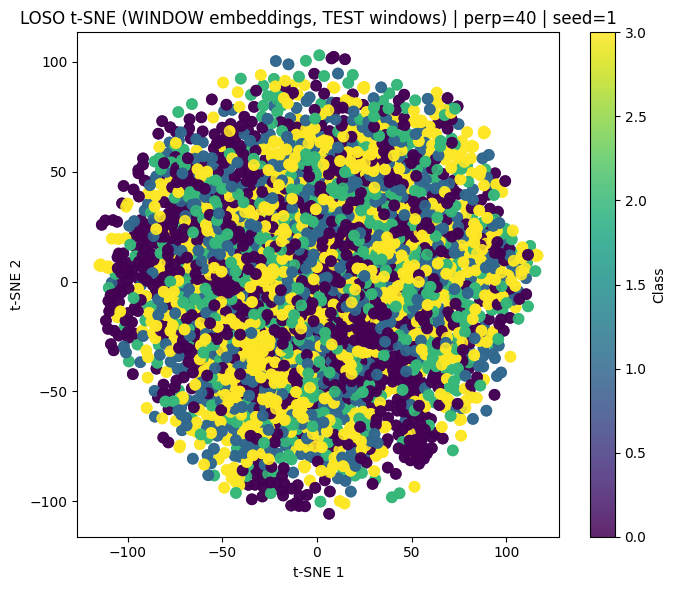

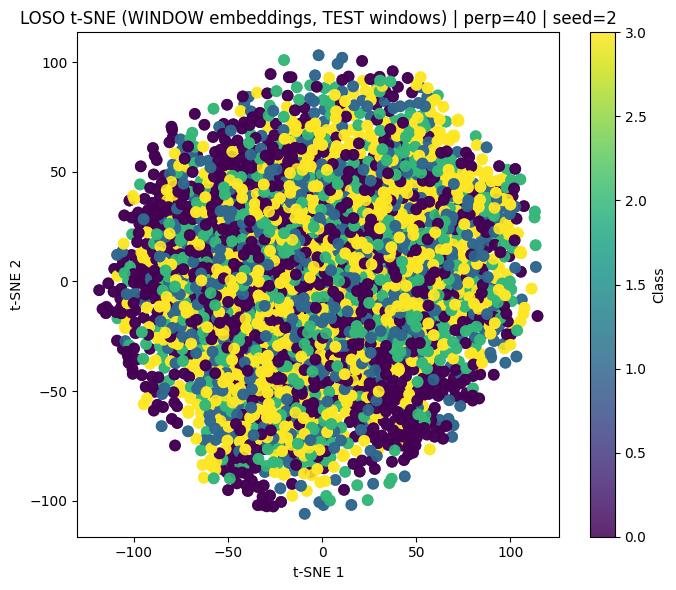

In [22]:
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
import matplotlib.pyplot as plt

from sklearn.model_selection import GroupShuffleSplit
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.metrics import (
    confusion_matrix,
    classification_report,
    balanced_accuracy_score,
    accuracy_score
)
from sklearn.metrics import balanced_accuracy_score

import torch.nn as nn

# =========================
# Utils
# =========================



def to_np(x):
    if isinstance(x, torch.Tensor):
        return x.detach().cpu().numpy()
    return np.asarray(x)

def to_str_np(x):
    return np.asarray(to_np(x)).astype(str).reshape(-1)


def pool_by_recording_torch(feat, y, rec):
    rec = np.asarray(rec).astype(str)
    uniq = np.unique(rec)
    Xr, Yr = [], []
    for rid in uniq:
        m = (rec == rid)
        Xr.append(feat[m].mean(dim=0))
        Yr.append(int(y[m][0].item()))
    return torch.stack(Xr, 0), torch.tensor(Yr, dtype=torch.long), uniq

# =========================
# MLP
# =========================
class MLP(nn.Module):
    def __init__(self, d_in, n_classes):
        super().__init__()
        self.net = nn.Sequential(
            nn.Linear(d_in, 256), nn.ReLU(), nn.Dropout(0.2),
            nn.Linear(256, 128), nn.ReLU(), nn.Dropout(0.2),
            nn.Linear(128, n_classes),
        )
    def forward(self, x):
        return self.net(x)

def train_mlp_with_val(Xtr_np, ytr_np, Xva_np, yva_np, num_classes, device,
                       max_epochs=300, patience=30, lr=1e-3, wd=1e-4, tau=1.0):

    Xtr = torch.tensor(Xtr_np, dtype=torch.float32).to(device)
    Xva = torch.tensor(Xva_np, dtype=torch.float32).to(device)
    ytr = torch.tensor(ytr_np, dtype=torch.long).to(device)
    yva = torch.tensor(yva_np, dtype=torch.long).to(device)

    clf = MLP(Xtr.shape[1], num_classes).to(device)

    counts = np.bincount(np.asarray(ytr_np).astype(int), minlength=num_classes)
    crit = LogitAdjustedCE(counts, tau=tau).to(device)


    opt  = optim.AdamW(clf.parameters(), lr=lr, weight_decay=wd)

    @torch.no_grad()
    def val_balacc():
        clf.eval()
        pred = clf(Xva).argmax(1).detach().cpu().numpy()
        true = yva.detach().cpu().numpy()
        return balanced_accuracy_score(true, pred)



    best, best_state, noimp = -1, None, 0
    for _ in range(max_epochs):
        clf.train()
        opt.zero_grad(set_to_none=True)
        loss = crit(clf(Xtr), ytr)
        loss.backward()
        opt.step()

        va = val_balacc()
        if va > best:
            best = va
            best_state = {k: v.detach().cpu().clone() for k, v in clf.state_dict().items()}
            noimp = 0
        else:
            noimp += 1
            if noimp >= patience:
                break

    if best_state is not None:
        clf.load_state_dict(best_state)
    return clf

# =========================
# Dataset (rec_id filter robust)
# =========================
from torch.utils.data import Dataset, DataLoader

class WindowDataset(Dataset):
    def __init__(self, X_all, y_all, rec_id_all, keep_rec_set):
        X_all = np.asarray(X_all)
        y_all = np.asarray(y_all)

        rec_id_all = np.asarray(rec_id_all).astype(str).reshape(-1)
        assert len(rec_id_all) == len(y_all) == X_all.shape[0], \
            f"Mismatch: rec_id={len(rec_id_all)} y={len(y_all)} X={X_all.shape}"

        mask = np.isin(rec_id_all, list(keep_rec_set))
        self.X = X_all[mask]
        self.y = y_all[mask]
        self.r = rec_id_all[mask]

    def __len__(self): return len(self.y)

    def __getitem__(self, i):
        return (torch.tensor(self.X[i], dtype=torch.float32),
                torch.tensor(self.y[i], dtype=torch.long),
                self.r[i])

# =========================
# t-SNE sweep utility
# =========================
def tsne_sweep(X_np, y_np, title_prefix, perplexities, seeds, pca_dim=30):
    X_np = np.asarray(X_np)
    y_np = np.asarray(y_np).astype(int).reshape(-1)
    assert len(X_np) == len(y_np)

    Xz = StandardScaler().fit_transform(X_np)
    k = min(pca_dim, Xz.shape[1])
    Xp = PCA(n_components=k, random_state=0).fit_transform(Xz)

    for perp in perplexities:
        if perp >= (len(Xp) - 1) / 3:   # regola pratica
            continue
        for seed in seeds:
            X2 = TSNE(
                n_components=2,
                perplexity=perp,
                init="pca",
                learning_rate="auto",
                random_state=seed
            ).fit_transform(Xp)

            plt.figure(figsize=(7,6))
            sc = plt.scatter(X2[:,0], X2[:,1], c=y_np, s=55, alpha=0.85)
            plt.colorbar(sc, label="Class")
            plt.title(f"{title_prefix} | perp={perp} | seed={seed}")
            plt.xlabel("t-SNE 1"); plt.ylabel("t-SNE 2")
            plt.tight_layout()
            plt.show()

# ============================================================
# LOSO MAIN (recording-level confusion + t-SNE)
# ============================================================
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
BATCH = 64

rec_ids_all = rec_id_win
subj_all = subj_win
subjects = np.unique(subj_all)

num_classes = int(np.max(y_all) + 1)

all_true, all_pred = [], []
all_true_win, all_pred_win = [], []

# per t-SNE LOSO recording-level: accumulo embedding test (pooled)
all_Xte_rec = []
all_yte_rec = []

# opzionale: per t-SNE LOSO windows: accumulo embedding window test (subsample)
DO_WINDOWS_TSNE = True
MAX_WIN_TSNE_PER_SUBJ = 500  # limita per subject per non esplodere
all_Xte_win = []
all_yte_win = []

rec_id_win = meta["rec_id"].astype(str)
subj_win   = meta["subject"].astype(str)


rec_ids = np.unique(rec_id_win)
rec_ids_all = rec_id_win
subj_all = subj_win
subjects = np.unique(subj_all)


# mappa recording -> subject (prendo il subject della prima finestra di quel recording)
rec_to_subj = {}
for rid in rec_ids:
    idx = np.where(rec_id_win == rid)[0][0]
    rec_to_subj[rid] = subj_win[idx]


for s in subjects:
    # TEST: tutti i recording del subject s
    test_rec = set(np.unique(rec_ids_all[subj_all == s]))

    # TRAINVAL: recording degli altri subject
    trainval_rec = np.unique(rec_ids_all[subj_all != s])

    # split train/val sui recording, grouped by subject
    trainval_subj = np.array([rec_to_subj[rid] for rid in trainval_rec])
    gss = GroupShuffleSplit(n_splits=1, test_size=0.2, random_state=42)
    tr_idx, va_idx = next(gss.split(trainval_rec, groups=trainval_subj))
    train_rec = set(trainval_rec[tr_idx])
    val_rec   = set(trainval_rec[va_idx])

    # loaders (WINDOW level)
    train_ds = WindowDataset(X_all, y_all, rec_ids_all, train_rec)
    val_ds   = WindowDataset(X_all, y_all, rec_ids_all, val_rec)
    test_ds  = WindowDataset(X_all, y_all, rec_ids_all, test_rec)

    train_loader = DataLoader(train_ds, batch_size=BATCH, shuffle=False)
    val_loader   = DataLoader(val_ds,   batch_size=BATCH, shuffle=False)
    test_loader  = DataLoader(test_ds,  batch_size=BATCH, shuffle=False)

    # EEGPT features window-level
    tr_feat, tr_y, tr_rec = extract_eegpt_features(model, train_loader, device, chan_ids_8)
    va_feat, va_y, va_rec = extract_eegpt_features(model, val_loader,   device, chan_ids_8)
    te_feat, te_y, te_rec = extract_eegpt_features(model, test_loader,  device, chan_ids_8)

    # ---- per t-SNE recording-level (SOLO plotting)
    Xrec_plot, yrec_plot, _ = build_recording_embeddings_for_plot(
        to_np(te_feat), to_np(te_y), te_rec
    )
    all_Xte_rec.append(Xrec_plot)
    all_yte_rec.append(yrec_plot)


    # =========================
    # WINDOW-LEVEL classifier (senza pooling)
    # =========================
    scaler_w = StandardScaler()
    Xtr_w_np = scaler_w.fit_transform(to_np(tr_feat))
    Xva_w_np = scaler_w.transform(to_np(va_feat))
    Xte_w_np = scaler_w.transform(to_np(te_feat))

    clf_w = train_mlp_with_val(
        Xtr_w_np, to_np(tr_y),
        Xva_w_np, to_np(va_y),
        num_classes=num_classes,
        device=device
    )

    with torch.no_grad():
        clf_w.eval()
        logits = clf_w(torch.tensor(Xte_w_np, dtype=torch.float32).to(device))
        probs  = torch.softmax(logits, dim=1).cpu().numpy()
        te_pred_w = np.argmax(probs, axis=1)

    # window-level metrics
    all_true_win.extend(to_np(te_y).tolist())
    all_pred_win.extend(te_pred_w.tolist())

    # recording-level: aggrega prob per recording
    y_true_rec, y_pred_rec, _ = aggregate_recording_pred_from_window_probs(
        probs=probs,
        y_win=to_np(te_y),
        rec_ids=te_rec,
        mode="logsum"   # prova anche "mean"
    )
    all_true.extend(y_true_rec.tolist())
    all_pred.extend(y_pred_rec.tolist())

    # t-SNE: se vuoi farla, fallo SOLO sulle windows (ha senso)
    if DO_WINDOWS_TSNE:
        Xw = to_np(te_feat)
        yw = to_np(te_y)
        if len(Xw) > MAX_WIN_TSNE_PER_SUBJ:
            rs = np.random.RandomState(0)
            idx = rs.choice(len(Xw), size=MAX_WIN_TSNE_PER_SUBJ, replace=False)
            Xw = Xw[idx]
            yw = yw[idx]
        all_Xte_win.append(Xw)
        all_yte_win.append(yw)


    # OPTIONAL: accumulate windows for t-SNE (subsample per subject)
    if DO_WINDOWS_TSNE:
        Xw = to_np(te_feat)         # (Nwin_test, D)
        yw = to_np(te_y)            # (Nwin_test,)
        if len(Xw) > MAX_WIN_TSNE_PER_SUBJ:
            rs = np.random.RandomState(0)
            idx = rs.choice(len(Xw), size=MAX_WIN_TSNE_PER_SUBJ, replace=False)
            Xw = Xw[idx]
            yw = yw[idx]
        all_Xte_win.append(Xw)
        all_yte_win.append(yw)

# ---- FINAL LOSO confusion matrix
cm = confusion_matrix(all_true, all_pred, labels=list(range(num_classes)))
print("LOSO Confusion matrix:\n", cm)
print("\nLOSO Report:\n", classification_report(all_true, all_pred, digits=3))

print("\n==============================")
print("LOSO WINDOW-LEVEL")
print("==============================")
print("Balanced Accuracy:", balanced_accuracy_score(all_true_win, all_pred_win))
print("Accuracy:", accuracy_score(all_true_win, all_pred_win))
cm_w = confusion_matrix(all_true_win, all_pred_win, labels=list(range(num_classes)))
print("Confusion matrix:\n", cm_w)
print("\nReport:\n", classification_report(all_true_win, all_pred_win, digits=3))


# ---- FINAL LOSO t-SNE (recording-level pooled test points)
X_tsne_rec = np.concatenate(all_Xte_rec, axis=0)   # ~60 x 512
y_tsne_rec = np.concatenate(all_yte_rec, axis=0)   # ~60

tsne_sweep(
    X_tsne_rec, y_tsne_rec,
    title_prefix="LOSO t-SNE (recording-level pooled, TEST points)",
    perplexities=(5, 8, 10, 12, 15),
    seeds=(0, 1, 2, 3),
    pca_dim=30
)

# ---- OPTIONAL: LOSO t-SNE windows (TEST windows across all LOSO iters)
if DO_WINDOWS_TSNE:
    X_tsne_win = np.concatenate(all_Xte_win, axis=0)
    y_tsne_win = np.concatenate(all_yte_win, axis=0)

    # per windows puoi usare perplexity più alta
    tsne_sweep(
        X_tsne_win, y_tsne_win,
        title_prefix="LOSO t-SNE (WINDOW embeddings, TEST windows)",
        perplexities=(10, 15, 20, 30, 40),
        seeds=(0, 1, 2),
        pca_dim=30
    )


# FDA

## A) Helper: estrarre finestre e rec_id dal Dataset (senza torch siccome non supportato da FDA)

In [ ]:
import numpy as np

def get_numpy_from_ds(ds):
    """
    ds: WindowDataset
    returns:
      X: (Nwin, C, T) float32
      y: (Nwin,) int64
      rec: (Nwin,) array dtype object/str
    """
    X = ds.X.astype(np.float32)
    y = ds.y.astype(np.int64)
    rec = np.asarray(ds.r)
    return X, y, rec


## B) Pooling per recording (uguale al tuo TSN pooling, ma numpy)

In [ ]:
def pool_by_recording(X_feat, y_win, rec_ids, agg="mean"):
    """
    X_feat: (Nwin, p)
    y_win : (Nwin,)
    rec_ids: (Nwin,) strings or objects
    returns:
      X_rec: (Nrec, p)
      y_rec: (Nrec,)
      rec_uniq: (Nrec,)
    """
    rec_ids = np.asarray(rec_ids).astype(str)
    uniq = np.unique(rec_ids)
    Xr, Yr = [], []
    for rid in uniq:
        m = (rec_ids == rid)
        if agg == "mean":
            Xr.append(X_feat[m].mean(axis=0))
        elif agg == "median":
            Xr.append(np.median(X_feat[m], axis=0))
        else:
            raise ValueError("agg must be mean or median")
        Yr.append(int(y_win[m][0]))
    return np.stack(Xr, axis=0), np.asarray(Yr, dtype=np.int64), uniq


## C) FDA baseline = “curve features” + PCA
Qui scegliamo due varianti:
1) PCA per-canale

    input: finestre (Nwin, 8, 1024)

    per ogni canale k: PCA su (Nwin, 1024)

    prendi K score

    concateni ⇒ (Nwin, 8K)
2) PCA globale

    appiattisci window → (Nwin, 8*1024)

    PCA globale, prendi K ⇒ (Nwin, K)

In [ ]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

def make_fda_features_per_channel(Xtr, Xva, Xte, K=8, center=True):
    """
    X*: (Nwin, C, T)
    returns features:
      Ftr: (Nwin_tr, C*K)
      Fva: (Nwin_va, C*K)
      Fte: (Nwin_te, C*K)
    """
    C, T = Xtr.shape[1], Xtr.shape[2]
    Ftr_list, Fva_list, Fte_list = [], [], []
    pca_list = []
    for k in range(C):
        Ytr = Xtr[:, k, :]  # (Ntr, T)
        Yva = Xva[:, k, :]
        Yte = Xte[:, k, :]

        # opzionale: centra (PCA con center=True già lo fa)
        pca = PCA(n_components=K, random_state=0)
        pca.fit(Ytr)  # FIT SOLO SU TRAIN
        pca_list.append(pca)

        Ftr_list.append(pca.transform(Ytr))
        Fva_list.append(pca.transform(Yva))
        Fte_list.append(pca.transform(Yte))

    Ftr = np.concatenate(Ftr_list, axis=1)
    Fva = np.concatenate(Fva_list, axis=1)
    Fte = np.concatenate(Fte_list, axis=1)
    return Ftr.astype(np.float32), Fva.astype(np.float32), Fte.astype(np.float32), pca_list

def make_fda_features_global(Xtr, Xva, Xte, K=32):
    """
    Flatten (C,T)->(C*T) then PCA on train
    """
    Ntr, C, T = Xtr.shape
    Ztr = Xtr.reshape(Ntr, C*T)
    Zva = Xva.reshape(Xva.shape[0], C*T)
    Zte = Xte.reshape(Xte.shape[0], C*T)

    pca = PCA(n_components=K, random_state=0)
    pca.fit(Ztr)  # FIT SOLO SU TRAIN

    Ftr = pca.transform(Ztr).astype(np.float32)
    Fva = pca.transform(Zva).astype(np.float32)
    Fte = pca.transform(Zte).astype(np.float32)
    return Ftr, Fva, Fte, pca


## D) Allinea il tuo “protocollo EEGPT”: pooling per recording + scaler + MLP

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from sklearn.metrics import confusion_matrix, classification_report

class MLP(nn.Module):
    def __init__(self, d_in, n_classes):
        super().__init__()
        self.net = nn.Sequential(
            nn.Linear(d_in, 256), nn.ReLU(), nn.Dropout(0.2),
            nn.Linear(256, 128), nn.ReLU(), nn.Dropout(0.2),
            nn.Linear(128, n_classes),
        )
    def forward(self, x): return self.net(x)

def train_mlp_recordlevel(Xtr_rec, ytr_rec, Xva_rec, yva_rec, Xte_rec, yte_rec,
                          num_classes, max_epochs=300, patience=30, lr=1e-3, wd=1e-4):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    # scaler fit su train
    scaler = StandardScaler()
    Xtr_np = scaler.fit_transform(Xtr_rec)
    Xva_np = scaler.transform(Xva_rec)
    Xte_np = scaler.transform(Xte_rec)

    Xtr = torch.tensor(Xtr_np, dtype=torch.float32).to(device)
    Xva = torch.tensor(Xva_np, dtype=torch.float32).to(device)
    Xte = torch.tensor(Xte_np, dtype=torch.float32).to(device)
    ytr = torch.tensor(ytr_rec, dtype=torch.long).to(device)
    yva = torch.tensor(yva_rec, dtype=torch.long).to(device)
    yte = torch.tensor(yte_rec, dtype=torch.long).to(device)

    clf = MLP(Xtr.shape[1], num_classes).to(device)
    criterion = nn.CrossEntropyLoss()
    opt = optim.AdamW(clf.parameters(), lr=lr, weight_decay=wd)

    @torch.no_grad()
    def eval_acc(X, y):
        clf.eval()
        pred = clf(X).argmax(1)
        return (pred == y).float().mean().item(), pred.detach().cpu().numpy()

    best_va = -1
    best_state = None
    noimp = 0

    for epoch in range(1, max_epochs+1):
        clf.train()
        opt.zero_grad(set_to_none=True)
        logits = clf(Xtr)
        loss = criterion(logits, ytr)
        loss.backward()
        opt.step()

        va_acc, _ = eval_acc(Xva, yva)
        if va_acc > best_va:
            best_va = va_acc
            best_state = {k: v.detach().cpu().clone() for k, v in clf.state_dict().items()}
            noimp = 0
        else:
            noimp += 1

        if epoch % 50 == 0 or epoch == 1:
            tr_acc = (logits.argmax(1) == ytr).float().mean().item()
            print(f"epoch {epoch:03d} | loss={loss.item():.3f} | tr_acc={tr_acc:.3f} | va_acc={va_acc:.3f} | best_va={best_va:.3f}")

        if noimp >= patience:
            print("Early stop.")
            break

    if best_state is not None:
        clf.load_state_dict(best_state)

    te_acc, te_pred = eval_acc(Xte, yte)
    print("\nTEST acc:", te_acc)
    cm = confusion_matrix(yte_rec, te_pred)
    print("Confusion matrix:\n", cm)
    print("\nReport:\n", classification_report(yte_rec, te_pred, digits=3))
    return te_acc, cm


## E) correlazione

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

def pool_probs_by_recording(P_w, r_w, agg="mean"):
    # P_w: (Nwin, C), r_w: (Nwin,)
    recs = np.unique(r_w)
    P_rec = []
    for rid in recs:
        m = (r_w == rid)
        if agg == "mean":
            P_rec.append(P_w[m].mean(axis=0))
        else:
            raise ValueError("Only mean supported")
    return np.vstack(P_rec), recs  # (Nrec, C), (Nrec,)

def spearman_corr_matrix(X, Y):
    # X: (N, D), Y: (N, C) -> corr: (D, C)
    from scipy.stats import spearmanr
    D = X.shape[1]
    C = Y.shape[1]
    corr = np.zeros((D, C))
    for d in range(D):
        for c in range(C):
            corr[d, c] = spearmanr(X[:, d], Y[:, c]).correlation
    return corr

def plot_corr_heatmap(corr, K_ch, channel_names, title="Corr(FPC score, EEGPT prob)"):
    # corr: (8*K_ch, num_classes)
    plt.figure(figsize=(7, 6))
    plt.imshow(corr, aspect="auto")
    plt.colorbar(label="Spearman ρ")
    plt.xlabel("EEGPT class")
    plt.ylabel("FPC feature (channel-blocked)")
    plt.title(title)

    # ytick leggibili: una label per canale
    yticks = [i*K_ch for i in range(len(channel_names))]
    plt.yticks(yticks, channel_names)
    plt.tight_layout()
    plt.show()

def top_corr_table(corr, K_ch, channel_names, topn=10):
    # stampa le correlazioni più forti in valore assoluto
    rows = []
    for f in range(corr.shape[0]):
        ch = f // K_ch
        k  = f % K_ch
        for c in range(corr.shape[1]):
            rows.append((abs(corr[f,c]), corr[f,c], channel_names[ch], k+1, c))
    rows.sort(reverse=True, key=lambda x: x[0])
    print("\nTop correlations (abs):")
    for a, r, ch, k, c in rows[:topn]:
        print(f"  |ρ|={a:.3f}  ρ={r:.3f}  feature={ch}-FPC{k}  vs class {c}")


## F) eegpt prob

In [ ]:
import torch

@torch.no_grad()
def eegpt_probs_windows(model, X_w, device, chan_ids_8, batch=64):
    model.eval()
    Ps = []
    for i in range(0, len(X_w), batch):
        xb = torch.tensor(X_w[i:i+batch], dtype=torch.float32).to(device)  # (B,8,1024)
        xb58 = embed_8_to_58(xb, chan_ids_8)  # tua funzione già esistente
        logits = model(xb58)                  # (B,3)
        Ps.append(torch.softmax(logits, dim=1).cpu().numpy())
    return np.vstack(Ps)


## LOSO

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

import numpy as np
import matplotlib.pyplot as plt

def plot_fpcs_for_channel(pca, fs=256, n_fpc=2, alpha=2.0, title=""):
    mean = pca.mean_
    comps = pca.components_
    lam = pca.explained_variance_
    T = mean.shape[0]
    t = np.arange(T) / fs

    plt.figure(figsize=(11, 4))
    plt.plot(t, mean, linewidth=2, label="mean")

    for j in range(n_fpc):
        phi = comps[j]
        amp = alpha * np.sqrt(lam[j])
        plt.plot(t, mean + amp*phi, linestyle="--", label=f"mean + {alpha}√λ{j+1}·FPC{j+1}")
        plt.plot(t, mean - amp*phi, linestyle="--", label=f"mean - {alpha}√λ{j+1}·FPC{j+1}")

    plt.xlabel("Time (s)")
    plt.ylabel("Amplitude (a.u.)")
    plt.title(title if title else "FPC shapes")
    plt.grid(alpha=0.2)
    plt.legend(ncol=2, fontsize=9)
    plt.tight_layout()
    plt.show()

def plot_explained_variance(pca, title=""):
    cum = np.cumsum(pca.explained_variance_ratio_)
    plt.figure(figsize=(6,4))
    plt.plot(np.arange(1, len(cum)+1), cum, marker="o")
    plt.ylim(0, 1.01)
    plt.xlabel("Number of FPCs (K)")
    plt.ylabel("Cumulative explained variance")
    plt.title(title if title else "Cumulative variance")
    plt.grid(alpha=0.2)
    plt.tight_layout()
    plt.show()



In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

def tsne_plot(Xtr, ytr, Xva, yva, Xte, yte, title="t-SNE (record-level)"):
    # concatena
    X = np.concatenate([Xtr, Xva, Xte], axis=0)
    y = np.concatenate([ytr, yva, yte], axis=0)

    # standardizza
    Xz = StandardScaler().fit_transform(X)

    # PCA pre t-SNE (stabilità/velocità)
    Xp = PCA(n_components=min(30, Xz.shape[1]), random_state=0).fit_transform(Xz)

    # t-SNE
    tsne = TSNE(
        n_components=2,
        perplexity=min(15, max(5, len(X)//4)),
        init="pca",
        learning_rate="auto",
        random_state=0
    )
    X2 = tsne.fit_transform(Xp)

    plt.figure(figsize=(7,6))
    sc = plt.scatter(X2[:,0], X2[:,1], c=y, s=50, alpha=0.85)
    plt.colorbar(sc, label="Class")
    plt.title(title)
    plt.xlabel("t-SNE 1"); plt.ylabel("t-SNE 2")
    plt.tight_layout()
    plt.show()

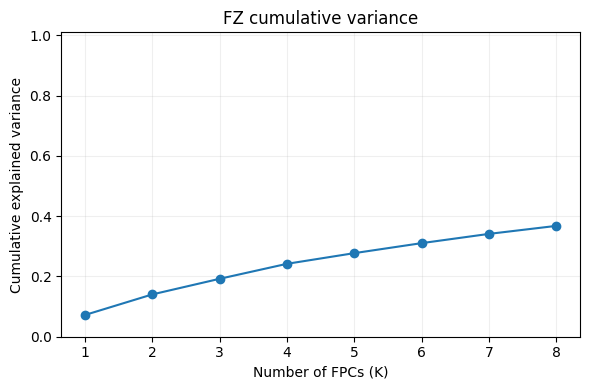

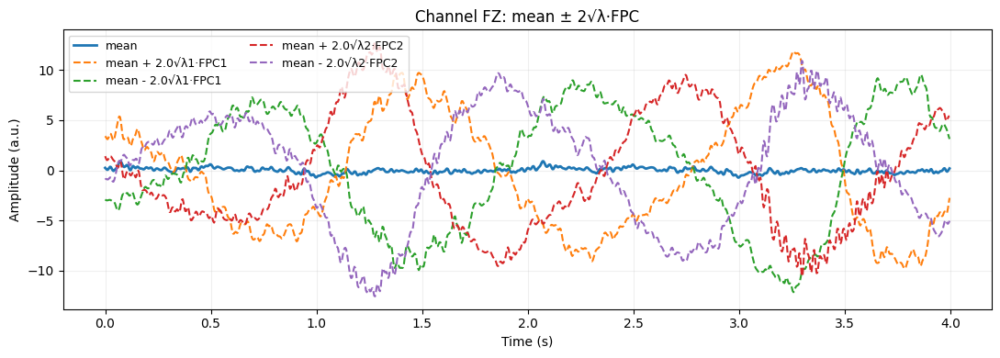

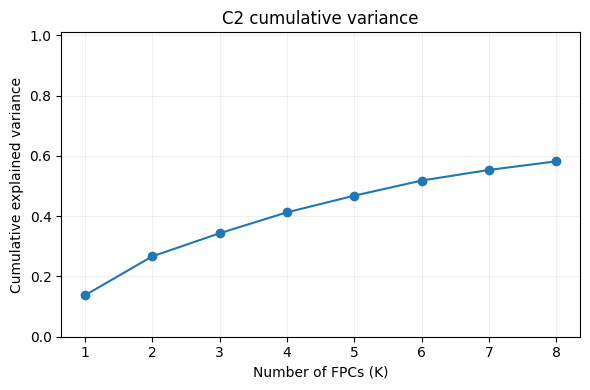

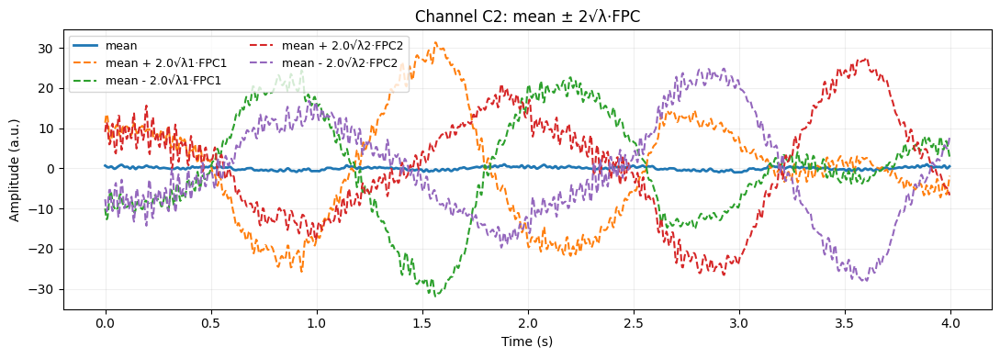


=== LOSO FDA per-channel (K_ch=8) ===
Confusion matrix:
 [[5 5 2 3]
 [6 3 4 2]
 [4 6 1 4]
 [2 2 2 9]]
              precision    recall  f1-score   support

           0      0.294     0.333     0.312        15
           1      0.188     0.200     0.194        15
           2      0.111     0.067     0.083        15
           3      0.500     0.600     0.545        15

    accuracy                          0.300        60
   macro avg      0.273     0.300     0.284        60
weighted avg      0.273     0.300     0.284        60


=== LOSO FDA global (K_glob=64) ===
Confusion matrix:
 [[2 2 9 2]
 [4 5 3 3]
 [1 4 4 6]
 [3 1 4 7]]
              precision    recall  f1-score   support

           0      0.200     0.133     0.160        15
           1      0.417     0.333     0.370        15
           2      0.200     0.267     0.229        15
           3      0.389     0.467     0.424        15

    accuracy                          0.300        60
   macro avg      0.301     0.300  

In [ ]:
import numpy as np
from sklearn.model_selection import GroupShuffleSplit
from sklearn.metrics import confusion_matrix, classification_report

# =========================
# 0) Window-level "source of truth"
# =========================
X_win_all = X_all          # DEVE essere (Nwin, 8, 1024)
y_win_all = y_all          # DEVE essere (Nwin,)
rec_id_win = meta["rec_id"].astype(str)
subj_win   = meta["subject"].astype(str)

assert X_win_all.shape[0] == len(y_win_all) == len(rec_id_win) == len(subj_win), \
    "Mismatch: assicurati che X_win_all/y_win_all/meta siano window-level!"

num_classes = 4

# =========================
# 1) Ricavo lista recording (60) + subject per recording
# =========================
rec_ids = np.unique(rec_id_win)  # 60
rec_subjects = np.array([rid.split("|")[-1] for rid in rec_ids])  # "...|S7" -> "S7"
subjects = np.unique(rec_subjects)

# =========================
# 2) WindowDataset (uguale al tuo)
# =========================
from torch.utils.data import Dataset

class WindowDataset(Dataset):
    def __init__(self, X_all, y_all, rec_id_all, keep_rec_set):
        mask = np.array([rid in keep_rec_set for rid in rec_id_all], dtype=bool)
        self.X = X_all[mask]
        self.y = y_all[mask]
        self.r = np.asarray(rec_id_all)[mask]
    def __len__(self): return len(self.y)
    def __getitem__(self, i):
        # qui non serve torch: ma la tua get_numpy_from_ds usa ds.X/ds.y/ds.r direttamente
        return self.X[i], self.y[i], self.r[i]

# =========================
# 3) LOSO loop: FDA per-channel + FDA global
#    Accumulo predizioni e faccio CM finale
# =========================
all_true_ch, all_pred_ch = [], []
all_true_g,  all_pred_g  = [], []

all_true_ch_w, all_pred_ch_w = [], []
all_true_g_w,  all_pred_g_w  = [], []

K_ch   = 8
K_glob = 64
tsne_cache = {}

from sklearn.preprocessing import StandardScaler
import torch
import torch.nn as nn
import torch.optim as optim

def train_mlp_windowlevel_return_pred(Xtr_w, ytr_w, Xva_w, yva_w, Xte_w, yte_w,
                                      num_classes, max_epochs=300, patience=30, lr=1e-3, wd=1e-4):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    scaler = StandardScaler()
    Xtr_np = scaler.fit_transform(Xtr_w)
    Xva_np = scaler.transform(Xva_w)
    Xte_np = scaler.transform(Xte_w)

    Xtr = torch.tensor(Xtr_np, dtype=torch.float32).to(device)
    Xva = torch.tensor(Xva_np, dtype=torch.float32).to(device)
    Xte = torch.tensor(Xte_np, dtype=torch.float32).to(device)
    ytr = torch.tensor(ytr_w, dtype=torch.long).to(device)
    yva = torch.tensor(yva_w, dtype=torch.long).to(device)
    yte = torch.tensor(yte_w, dtype=torch.long).to(device)

    clf = MLP(Xtr.shape[1], num_classes).to(device)
    criterion = nn.CrossEntropyLoss()
    opt = optim.AdamW(clf.parameters(), lr=lr, weight_decay=wd)

    @torch.no_grad()
    def eval_acc(X, y):
        clf.eval()
        pred = clf(X).argmax(1)
        return (pred == y).float().mean().item(), pred.detach().cpu().numpy()

    best_va, best_state, noimp = -1, None, 0
    for _ in range(max_epochs):
        clf.train()
        opt.zero_grad(set_to_none=True)
        loss = criterion(clf(Xtr), ytr)
        loss.backward()
        opt.step()

        va_acc, _ = eval_acc(Xva, yva)
        if va_acc > best_va:
            best_va = va_acc
            best_state = {k: v.detach().cpu().clone() for k, v in clf.state_dict().items()}
            noimp = 0
        else:
            noimp += 1
            if noimp >= patience:
                break

    if best_state is not None:
        clf.load_state_dict(best_state)

    te_acc, te_pred = eval_acc(Xte, yte)
    return te_acc, te_pred


for s in subjects:
    # --- split recording-level: test subject s
    test_rec = set(rec_ids[rec_subjects == s])
    trainval_rec = rec_ids[rec_subjects != s]
    trainval_subjects = rec_subjects[rec_subjects != s]

    # --- train/val split dentro trainval (recording-level, group by subject)
    gss = GroupShuffleSplit(n_splits=1, test_size=0.2, random_state=42)
    tr_idx, va_idx = next(gss.split(trainval_rec, groups=trainval_subjects))
    train_rec = set(trainval_rec[tr_idx])
    val_rec   = set(trainval_rec[va_idx])

    # --- costruisci i dataset window-level
    train_ds = WindowDataset(X_win_all, y_win_all, rec_id_win, train_rec)
    val_ds   = WindowDataset(X_win_all, y_win_all, rec_id_win, val_rec)
    test_ds  = WindowDataset(X_win_all, y_win_all, rec_id_win, test_rec)

    # --- estrai numpy windows
    Xtr_w, ytr_w, rtr = get_numpy_from_ds(train_ds)
    Xva_w, yva_w, rva = get_numpy_from_ds(val_ds)
    Xte_w, yte_w, rte = get_numpy_from_ds(test_ds)

    # ==========================================================
    # (A) FDA per-channel PCA
    # ==========================================================
    Ftr_w, Fva_w, Fte_w, pca_list = make_fda_features_per_channel(Xtr_w, Xva_w, Xte_w, K=K_ch)
    # --- WINDOW-LEVEL eval (per-channel)
    te_acc_ch_w, te_pred_ch_w = train_mlp_windowlevel_return_pred(
        Ftr_w, ytr_w,
        Fva_w, yva_w,
        Fte_w, yte_w,
        num_classes=num_classes
    )
    all_true_ch_w.extend(yte_w.tolist())
    all_pred_ch_w.extend(te_pred_ch_w.tolist())




    if s == subjects[0]:


        channel_names = ["FP1","FP2","F7","F3","FZ","F4","F8","C2"]
        for ch_idx in [4, 7]:  # FZ e C2
            plot_explained_variance(pca_list[ch_idx], title=f"{channel_names[ch_idx]} cumulative variance")
            plot_fpcs_for_channel(
                pca_list[ch_idx],
                fs=256,
                n_fpc=2,
                alpha=2.0,
                title=f"Channel {channel_names[ch_idx]}: mean ± 2√λ·FPC"
        )



    Xtr_rec, ytr_rec, _ = pool_by_recording(Ftr_w, ytr_w, rtr, agg="mean")
    Xva_rec, yva_rec, _ = pool_by_recording(Fva_w, yva_w, rva, agg="mean")
    Xte_rec, yte_rec, _ = pool_by_recording(Fte_w, yte_w, rte, agg="mean")




    # train MLP (ritorna acc e cm ma a noi serve pred: facciamo una piccola modifica sotto)
    # -> usiamo la tua train_mlp_recordlevel, ma serve anche te_pred.
    #   versione rapida: copio qui un wrapper che ritorna anche le predizioni.
    import torch
    import torch.nn as nn
    import torch.optim as optim
    from sklearn.preprocessing import StandardScaler

    def train_mlp_recordlevel_return_pred(Xtr_rec, ytr_rec, Xva_rec, yva_rec, Xte_rec, yte_rec,
                                          num_classes, max_epochs=300, patience=30, lr=1e-3, wd=1e-4):
        device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        scaler = StandardScaler()
        Xtr_np = scaler.fit_transform(Xtr_rec)
        Xva_np = scaler.transform(Xva_rec)
        Xte_np = scaler.transform(Xte_rec)

        Xtr = torch.tensor(Xtr_np, dtype=torch.float32).to(device)
        Xva = torch.tensor(Xva_np, dtype=torch.float32).to(device)
        Xte = torch.tensor(Xte_np, dtype=torch.float32).to(device)
        ytr = torch.tensor(ytr_rec, dtype=torch.long).to(device)
        yva = torch.tensor(yva_rec, dtype=torch.long).to(device)
        yte = torch.tensor(yte_rec, dtype=torch.long).to(device)

        clf = MLP(Xtr.shape[1], num_classes).to(device)
        criterion = nn.CrossEntropyLoss()
        opt = optim.AdamW(clf.parameters(), lr=lr, weight_decay=wd)

        @torch.no_grad()
        def eval_acc(X, y):
            clf.eval()
            pred = clf(X).argmax(1)
            return (pred == y).float().mean().item(), pred.detach().cpu().numpy()

        best_va = -1
        best_state = None
        noimp = 0

        for epoch in range(1, max_epochs+1):
            clf.train()
            opt.zero_grad(set_to_none=True)
            logits = clf(Xtr)
            loss = criterion(logits, ytr)
            loss.backward()
            opt.step()

            va_acc, _ = eval_acc(Xva, yva)
            if va_acc > best_va:
                best_va = va_acc
                best_state = {k: v.detach().cpu().clone() for k, v in clf.state_dict().items()}
                noimp = 0
            else:
                noimp += 1
            if noimp >= patience:
                break

        if best_state is not None:
            clf.load_state_dict(best_state)

        te_acc, te_pred = eval_acc(Xte, yte)
        return te_acc, te_pred  # <-- predizioni su test (recording-level)

    te_acc_ch, te_pred_ch = train_mlp_recordlevel_return_pred(
        Xtr_rec, ytr_rec, Xva_rec, yva_rec, Xte_rec, yte_rec,
        num_classes=num_classes
    )

    all_true_ch.extend(yte_rec.tolist())
    all_pred_ch.extend(te_pred_ch.tolist())

    # ==========================================================
    # (B) FDA global PCA
    # ==========================================================
    Gtr_w, Gva_w, Gte_w, _ = make_fda_features_global(Xtr_w, Xva_w, Xte_w, K=K_glob)

    # --- WINDOW-LEVEL eval (global)
    te_acc_g_w, te_pred_g_w = train_mlp_windowlevel_return_pred(
        Gtr_w, ytr_w,
        Gva_w, yva_w,
        Gte_w, yte_w,
        num_classes=num_classes
    )
    all_true_g_w.extend(yte_w.tolist())
    all_pred_g_w.extend(te_pred_g_w.tolist())


    Xtr_rec_g, ytr_rec_g, _ = pool_by_recording(Gtr_w, ytr_w, rtr, agg="mean")
    Xva_rec_g, yva_rec_g, _ = pool_by_recording(Gva_w, yva_w, rva, agg="mean")
    Xte_rec_g, yte_rec_g, _ = pool_by_recording(Gte_w, yte_w, rte, agg="mean")

    if s == subjects[0]:
        tsne_cache["ch"] = (Xtr_rec, ytr_rec, Xva_rec, yva_rec, Xte_rec, yte_rec)
        tsne_cache["g"]  = (Xtr_rec_g, ytr_rec_g, Xva_rec_g, yva_rec_g, Xte_rec_g, yte_rec_g)

    te_acc_g, te_pred_g = train_mlp_recordlevel_return_pred(
        Xtr_rec_g, ytr_rec_g, Xva_rec_g, yva_rec_g, Xte_rec_g, yte_rec_g,
        num_classes=num_classes
    )

    all_true_g.extend(yte_rec_g.tolist())
    all_pred_g.extend(te_pred_g.tolist())

# =========================
# 4) Confusion matrices finali (LOSO)
# =========================
cm_ch = confusion_matrix(all_true_ch, all_pred_ch)
print("\n=== LOSO FDA per-channel (K_ch=%d) ===" % K_ch)
print("Confusion matrix:\n", cm_ch)
print(classification_report(all_true_ch, all_pred_ch, digits=3))

cm_g = confusion_matrix(all_true_g, all_pred_g)
print("\n=== LOSO FDA global (K_glob=%d) ===" % K_glob)
print("Confusion matrix:\n", cm_g)
print(classification_report(all_true_g, all_pred_g, digits=3))

from sklearn.metrics import balanced_accuracy_score, accuracy_score

print("\n=== LOSO FDA per-channel | WINDOW-LEVEL (K_ch=%d) ===" % K_ch)
print("Balanced Accuracy:", balanced_accuracy_score(all_true_ch_w, all_pred_ch_w))
print("Accuracy:", accuracy_score(all_true_ch_w, all_pred_ch_w))
cm_ch_w = confusion_matrix(all_true_ch_w, all_pred_ch_w)
print("Confusion matrix:\n", cm_ch_w)
print(classification_report(all_true_ch_w, all_pred_ch_w, digits=3))

print("\n=== LOSO FDA global | WINDOW-LEVEL (K_glob=%d) ===" % K_glob)
print("Balanced Accuracy:", balanced_accuracy_score(all_true_g_w, all_pred_g_w))
print("Accuracy:", accuracy_score(all_true_g_w, all_pred_g_w))
cm_g_w = confusion_matrix(all_true_g_w, all_pred_g_w)
print("Confusion matrix:\n", cm_g_w)
print(classification_report(all_true_g_w, all_pred_g_w, digits=3))


the figure  shows the first two functional principal components for channel C2.
The first component mainly captures slow, large-scale oscillatory variations of the EEG signal, corresponding to global amplitude modulations.
The second component instead reflects faster temporal fluctuations, emphasizing more rapid oscillatory patterns.
Although variance is distributed across several components, these two modes already provide an interpretable summary of the dominant temporal dynamics

In [ ]:
print("X_all:", np.shape(X_all))
print("y_all:", np.shape(y_all))
print('meta["rec_id"]:', np.shape(meta["rec_id"]))
print('meta["subject"]:', np.shape(meta["subject"]))


X_all: (2520, 8, 1024)
y_all: (2520,)
meta["rec_id"]: (2520,)
meta["subject"]: (2520,)


## t-SNE su FDA a livello recording (stesso stile del tuo TSN)

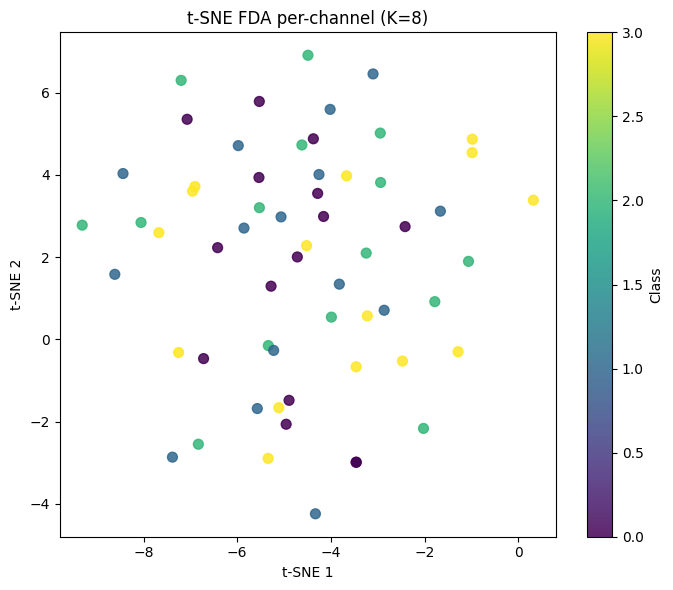

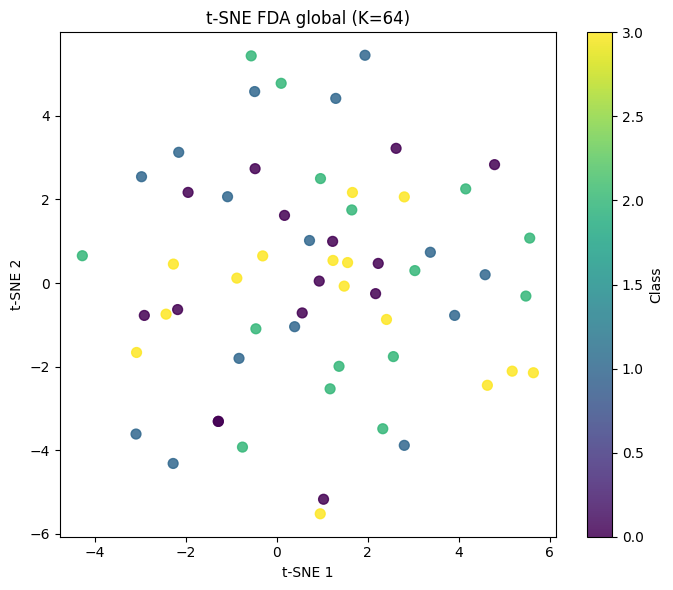

In [ ]:
Xtr_rec, ytr_rec, Xva_rec, yva_rec, Xte_rec, yte_rec = tsne_cache["ch"]
tsne_plot(Xtr_rec, ytr_rec, Xva_rec, yva_rec, Xte_rec, yte_rec,
          title=f"t-SNE FDA per-channel (K={K_ch})")

Xtr_rec_g, ytr_rec_g, Xva_rec_g, yva_rec_g, Xte_rec_g, yte_rec_g = tsne_cache["g"]
tsne_plot(Xtr_rec_g, ytr_rec_g, Xva_rec_g, yva_rec_g, Xte_rec_g, yte_rec_g,
          title=f"t-SNE FDA global (K={K_glob})")
